In [1]:
import numpy as np
from matplotlib import pyplot as plt
from skimage import io, color
from tifffile import imsave
from tqdm import tqdm
from time import time
from math import ceil
import cv2
import glob
import os
from shutil import copyfile
from random import sample
from PIL import Image

def image_show(image, nrows=1, ncols=1, cmap='gray',size = 8):
#     large_image = np.zeros((image.shape[0]+2,image.shape[1]+2), dtype = image.dtype) #add black border
#     large_image[1:-1,1:-1] = image
    
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(size, size))
    ax.imshow(image, cmap='gray')
    ax.axis('off')
    plt.show()
    return fig, ax

for individual processing

In [ ]:
########individual processing
biopsy_name = 's053d'
ch = '2'
ovlp = 0.25

ch_folder = 'W:\\WX_test_dod\\whole_biopsy\\four_biopsies\\test\\ch'+ch
seq_list = glob.glob(os.path.join(ch_folder, 'dod_'+biopsy_name+'*'))
print(len(seq_list))
seq_name_list = []
for seq in seq_list:
    seq_name = os.path.basename(seq)[:-1]
    if seq_name not in seq_name_list:
        seq_name_list.append(seq_name)
print(len(seq_name_list))

full_seq_folder = 'W:\\WX_test_dod\\whole_biopsy\\vid2vid_results\\test_whbio4biopsies\\full_seq'
ch_save_folder = os.path.join(full_seq_folder, 'Fused_dod_'+biopsy_name+'\\ch'+ch)
if not os.path.exists(ch_save_folder):
    os.makedirs(ch_save_folder)

In [ ]:
#from test data, no need for all the clipping and normalization
for seq_idx, seq_name in enumerate(seq_name_list): #seq_name_list, (all the blocks in this biopsy)
   
    print('-----------', seq_name)
        
    #top part    
    top_seq_dir = os.path.join(ch_folder, seq_name+'t')
    top_seq_frame_list = glob.glob(os.path.join(top_seq_dir,'dod*.jpg')) #cyto or nuc
    nf_top = len(top_seq_frame_list)
    print('nf_top', nf_top)
    #read top
    top_half = np.zeros((nf_top,1024,1024),dtype = np.uint8)
    print('reading top half...')
    for idx in range(nf_top): #range(nf_top)
        frame_dir = top_seq_frame_list[idx]
        frame = io.imread(frame_dir, as_gray = True)
        if np.amax(frame)<2:
            frame = frame*255
        top_half[nf_top-idx-1] = frame.astype(np.uint8) #go backwards
    print('len(top_half)', len(top_half))
    image_show(top_half[len(top_half)//2])

    #bottom part
    bot_seq_dir = os.path.join(ch_folder, seq_name+'b')
    bot_seq_frame_list = glob.glob(os.path.join(bot_seq_dir,'dod*.jpg'))
    nf_bot = len(bot_seq_frame_list)
    print('nf_bot', nf_bot)
    #read bottom
    bot_half = np.zeros((nf_bot,1024,1024),dtype = np.uint8)
    print('reading bottom half...')
    for idx in range(nf_bot):
        frame_dir = bot_seq_frame_list[idx]
        frame = io.imread(frame_dir, as_gray = True)
        if np.amax(frame)<2:
            frame = frame*255
        bot_half[idx] = frame.astype(np.uint8)
    print('len(bot_half)', len(bot_half))
    image_show(bot_half[len(bot_half)//2])
    
    #assemble whole seq (top and bottom)
    full_height = nf_top+nf_bot-2 #2 frames overlapping
    full_seq = np.zeros((full_height,1024,1024), dtype = np.uint8)
    full_seq[:nf_top] = top_half
    full_seq[nf_top:] = bot_half[2:]
    image_show(full_seq[len(full_seq)//2])
    
    #put this block into correct position in the whole biopsy
    if seq_idx==0:
        biopsy_length = int(1024*(len(seq_name_list)-1)*(1-ovlp)+1024)
        whobio = np.zeros((full_height, biopsy_length, 1024), dtype = np.uint8)
    
    l_strt = int(1024*seq_idx*(1-ovlp))
    l_end = int(1024*seq_idx*(1-ovlp)+1024)
    
    whobio[:,l_strt:l_end,:] = full_seq

#save whole biopsy
whobio_dir = os.path.join(ch_save_folder, biopsy_name+'_ch'+ch+'.tif')
imsave(whobio_dir, whobio)

for batch process

48
24
----------- dod_s198a_blk000
nf_top 375
reading top half...
len(top_half) 375


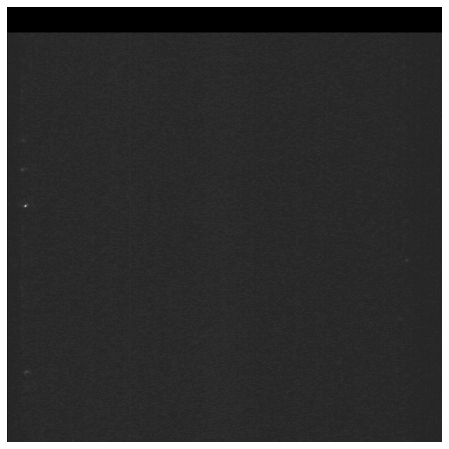

nf_bot 371
reading bottom half...
len(bot_half) 371


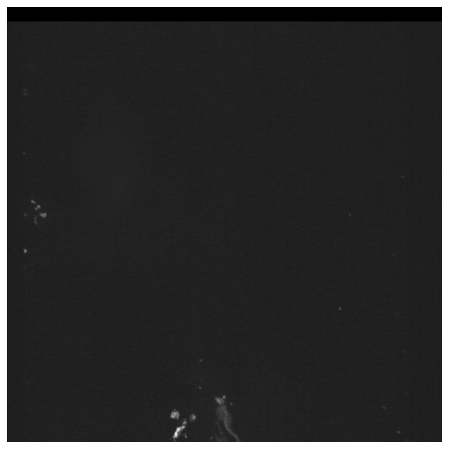

full_height 712


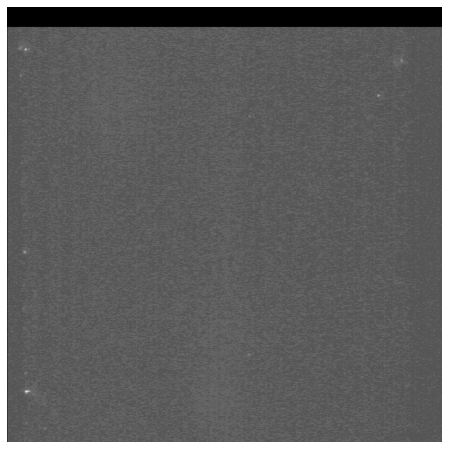

----------- dod_s198a_blk001
nf_top 375
reading top half...
len(top_half) 375


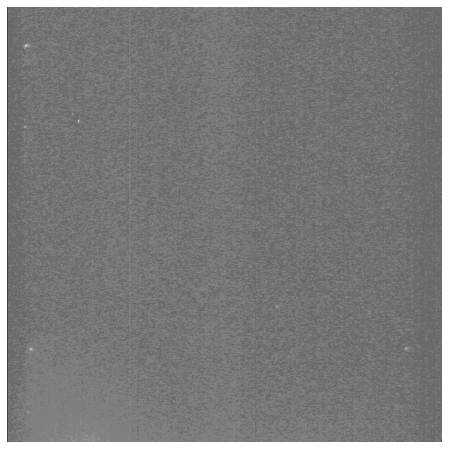

nf_bot 371
reading bottom half...
len(bot_half) 371


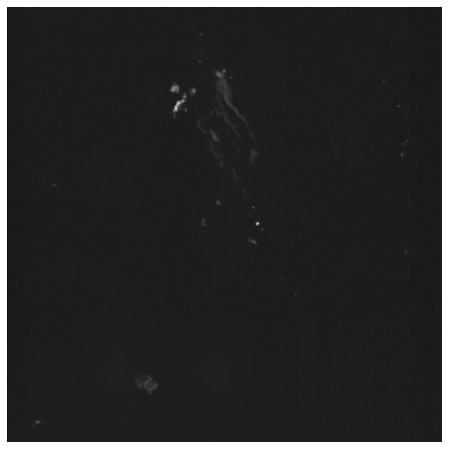

full_height 712


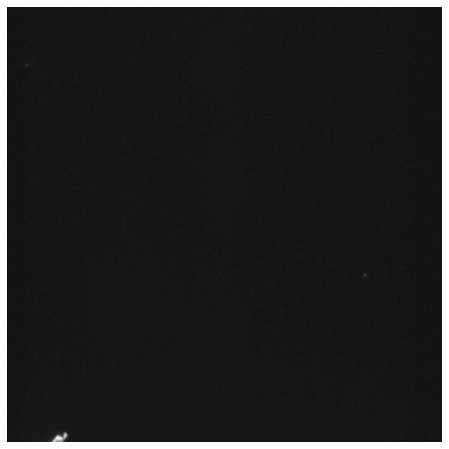

----------- dod_s198a_blk002
nf_top 375
reading top half...
len(top_half) 375


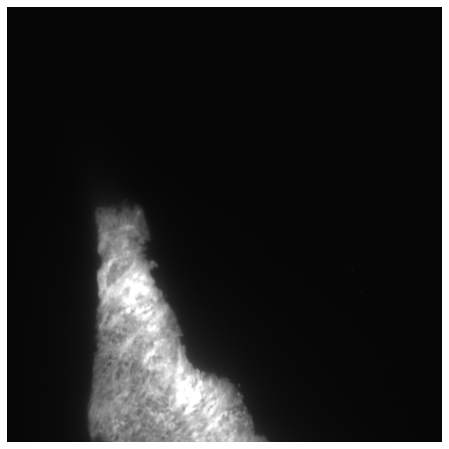

nf_bot 371
reading bottom half...
len(bot_half) 371


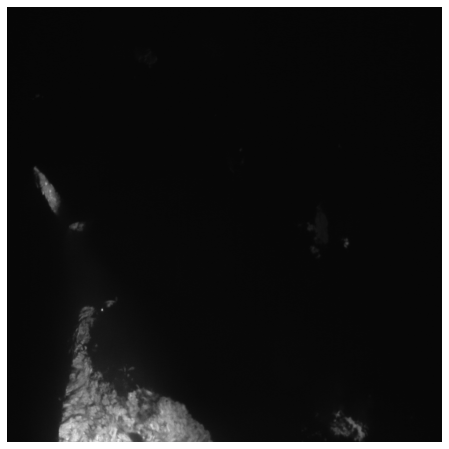

full_height 712


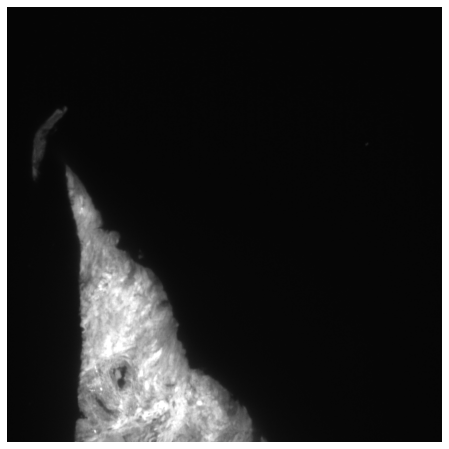

----------- dod_s198a_blk003
nf_top 375
reading top half...
len(top_half) 375


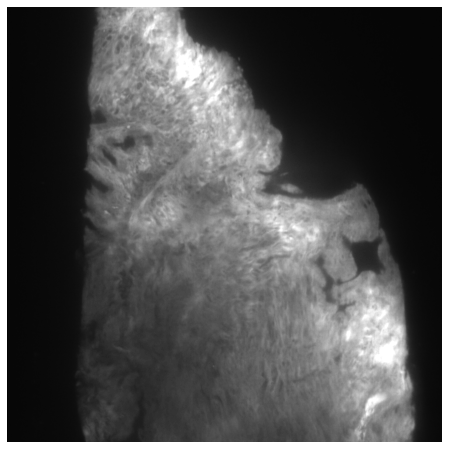

nf_bot 371
reading bottom half...
len(bot_half) 371


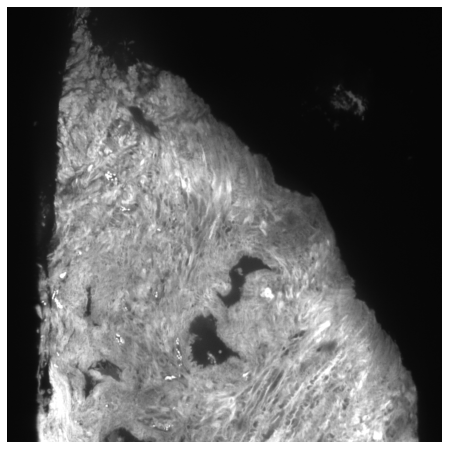

full_height 712


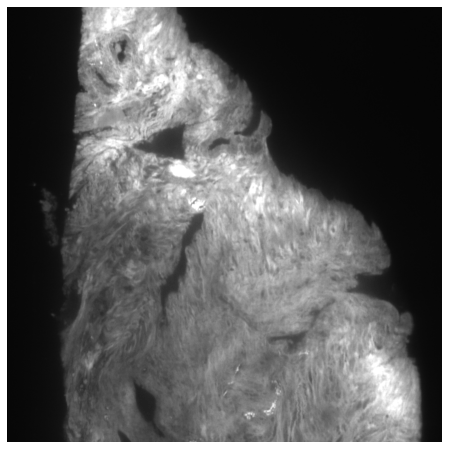

----------- dod_s198a_blk004
nf_top 375
reading top half...
len(top_half) 375


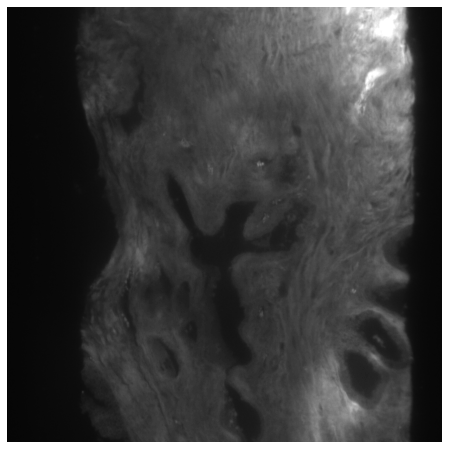

nf_bot 371
reading bottom half...
len(bot_half) 371


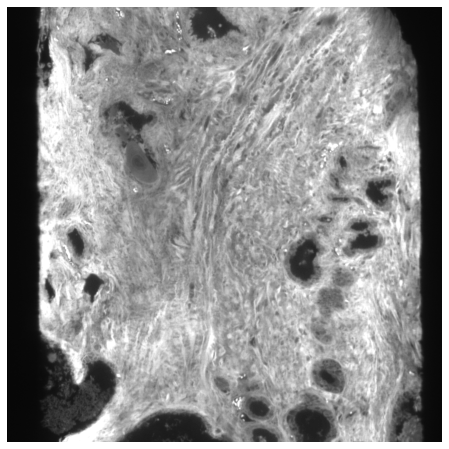

full_height 712


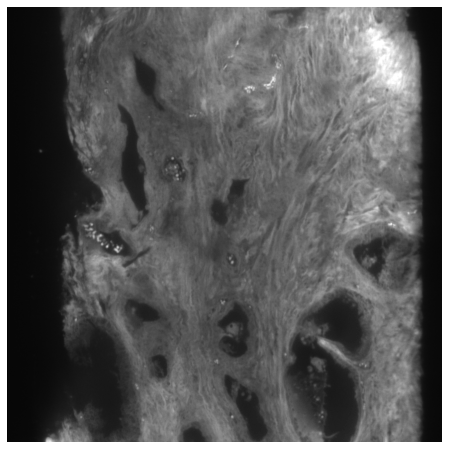

----------- dod_s198a_blk005
nf_top 375
reading top half...
len(top_half) 375


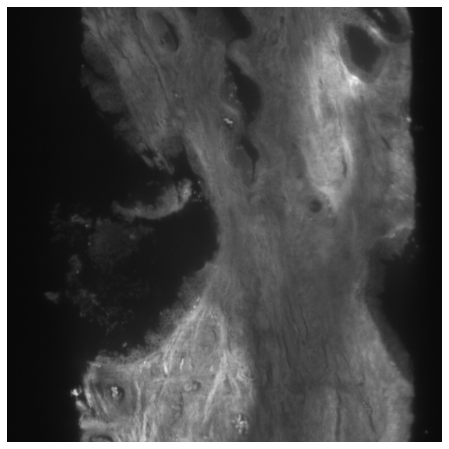

nf_bot 371
reading bottom half...
len(bot_half) 371


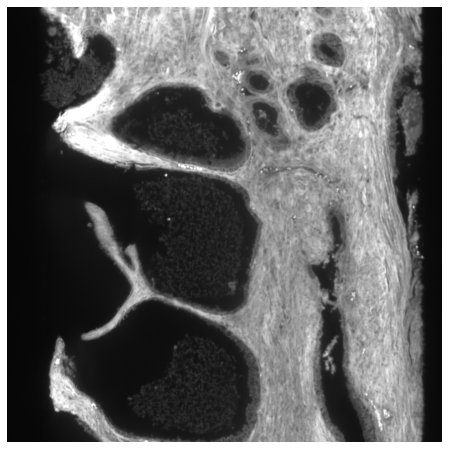

full_height 712


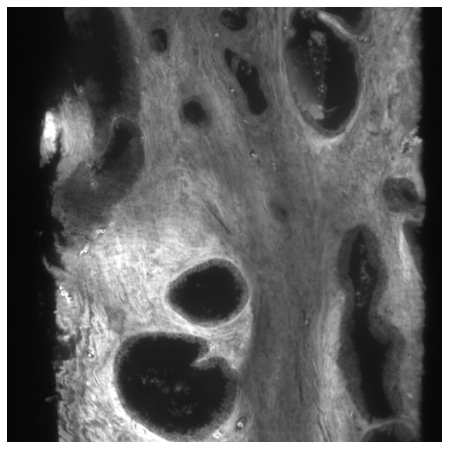

----------- dod_s198a_blk006
nf_top 375
reading top half...
len(top_half) 375


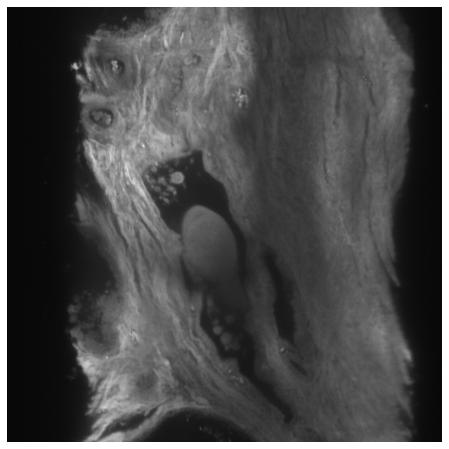

nf_bot 371
reading bottom half...
len(bot_half) 371


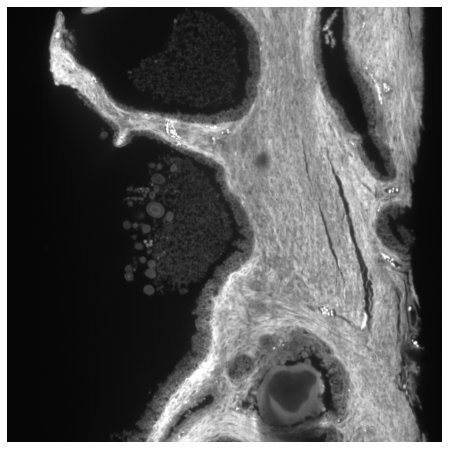

full_height 712


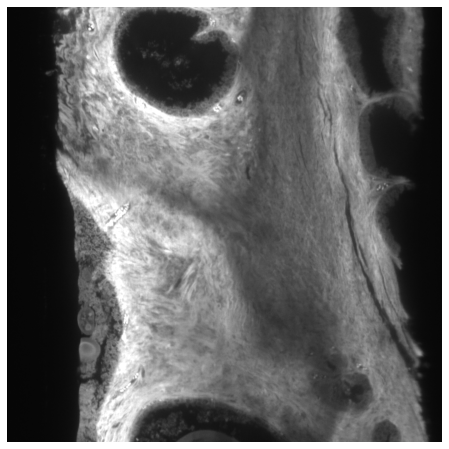

----------- dod_s198a_blk007
nf_top 375
reading top half...
len(top_half) 375


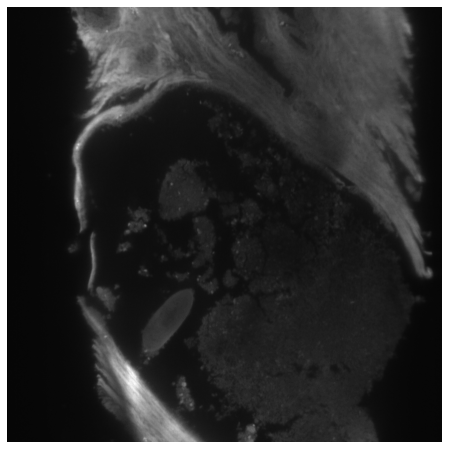

nf_bot 371
reading bottom half...
len(bot_half) 371


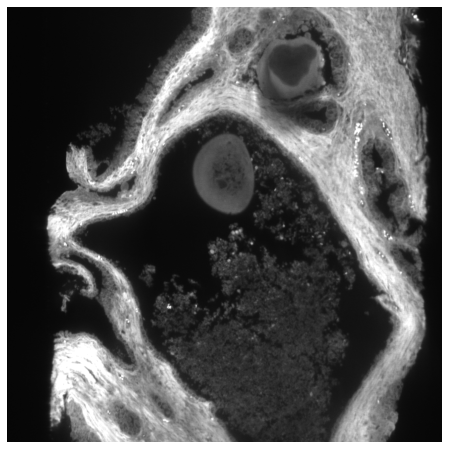

full_height 712


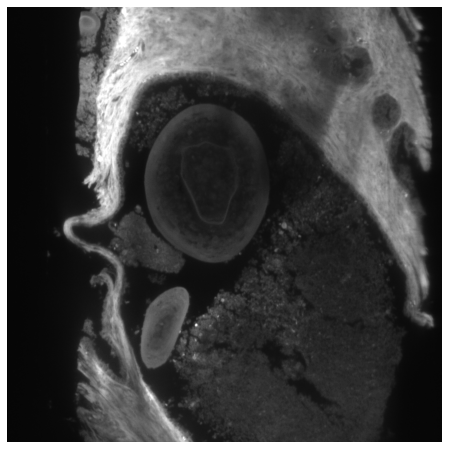

----------- dod_s198a_blk008
nf_top 375
reading top half...
len(top_half) 375


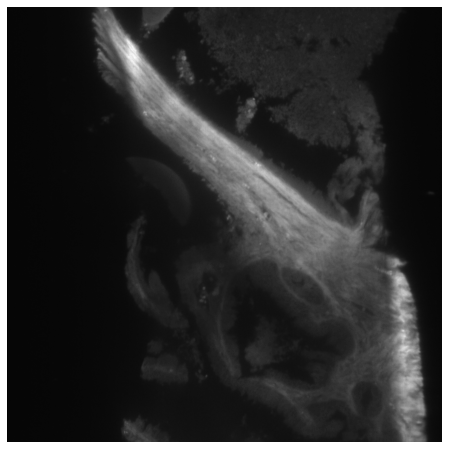

nf_bot 371
reading bottom half...
len(bot_half) 371


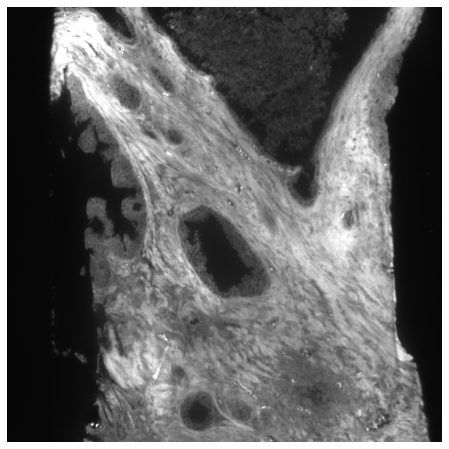

full_height 712


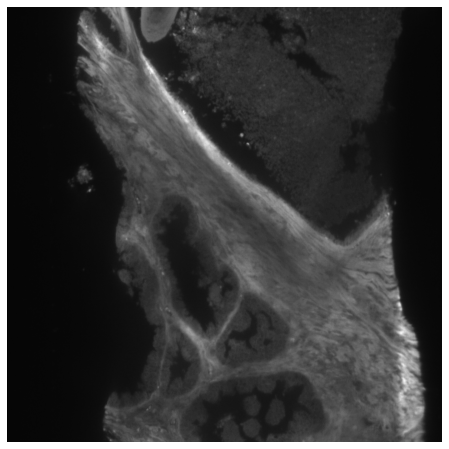

----------- dod_s198a_blk009
nf_top 375
reading top half...
len(top_half) 375


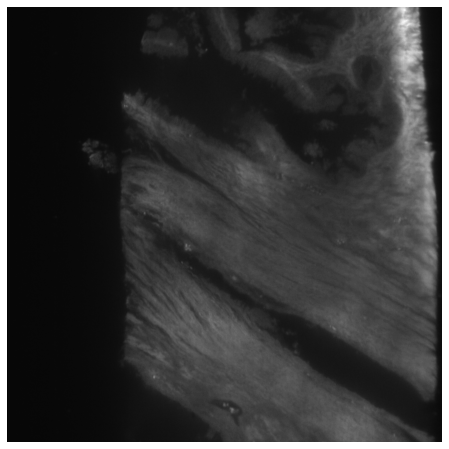

nf_bot 371
reading bottom half...
len(bot_half) 371


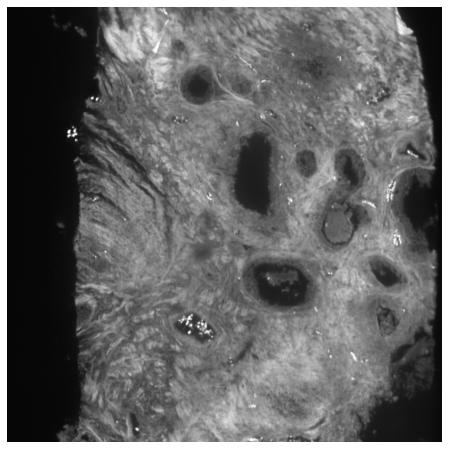

full_height 712


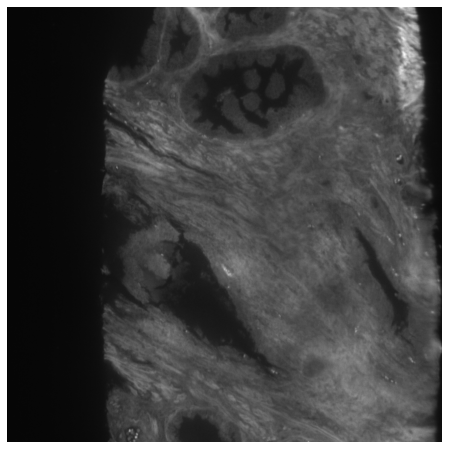

----------- dod_s198a_blk010
nf_top 375
reading top half...
len(top_half) 375


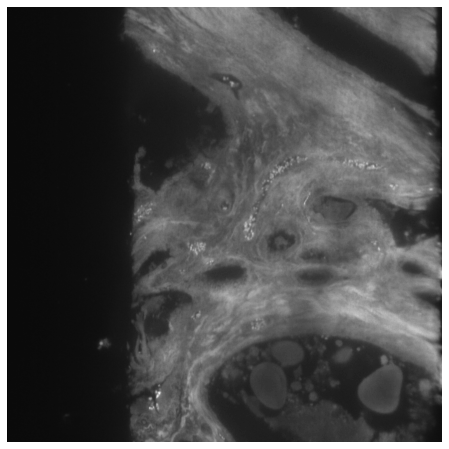

nf_bot 371
reading bottom half...
len(bot_half) 371


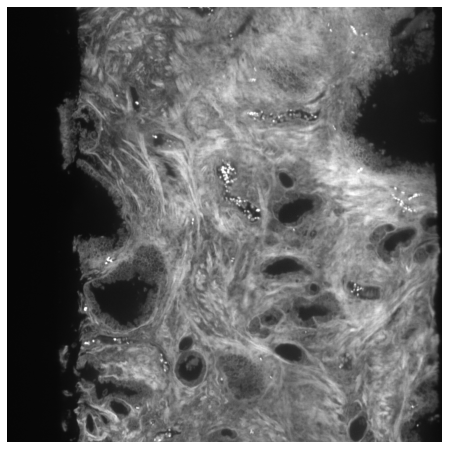

full_height 712


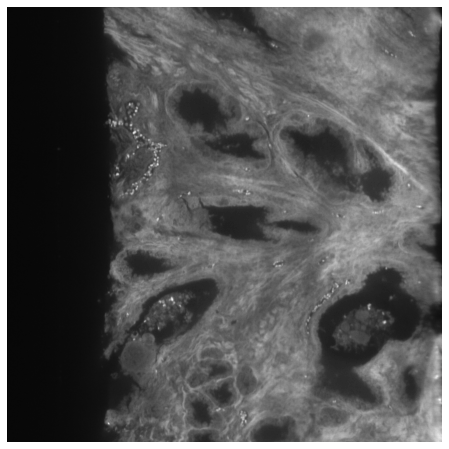

----------- dod_s198a_blk011
nf_top 375
reading top half...
len(top_half) 375


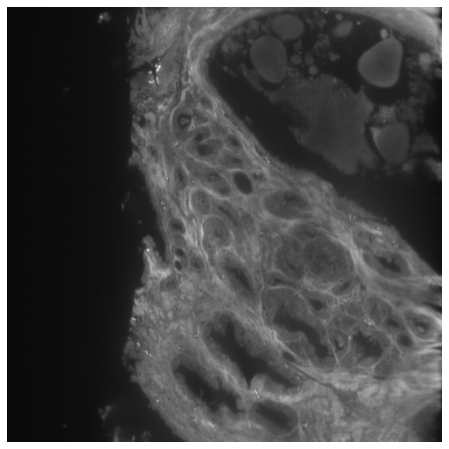

nf_bot 371
reading bottom half...
len(bot_half) 371


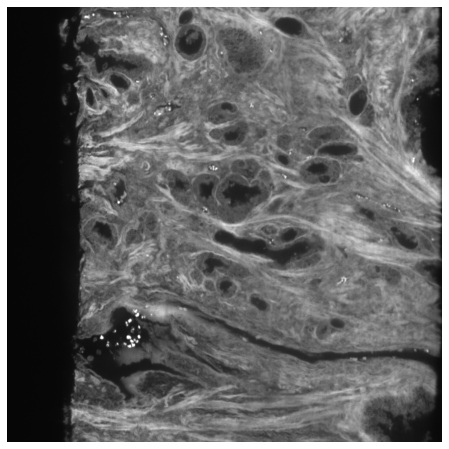

full_height 712


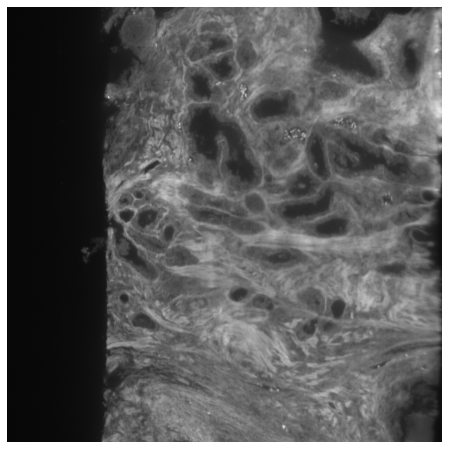

----------- dod_s198a_blk012
nf_top 375
reading top half...
len(top_half) 375


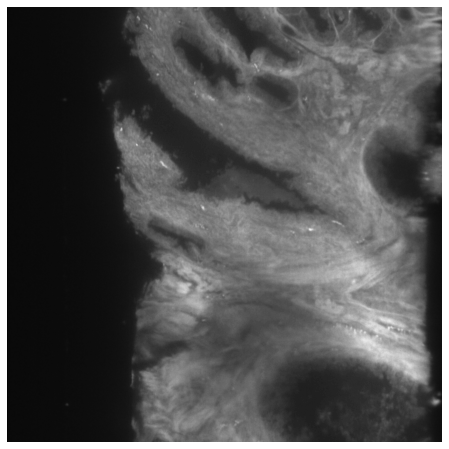

nf_bot 371
reading bottom half...
len(bot_half) 371


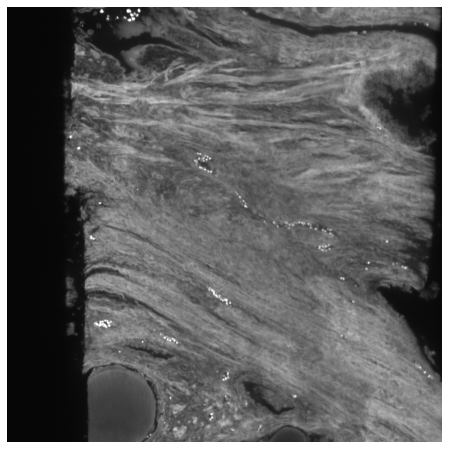

full_height 712


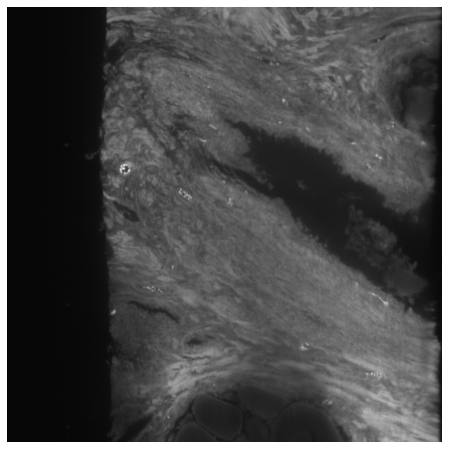

----------- dod_s198a_blk013
nf_top 375
reading top half...
len(top_half) 375


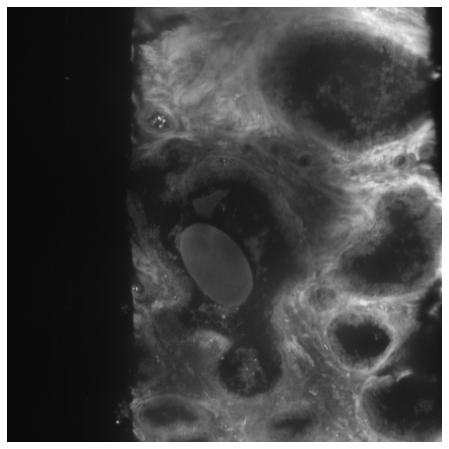

nf_bot 371
reading bottom half...
len(bot_half) 371


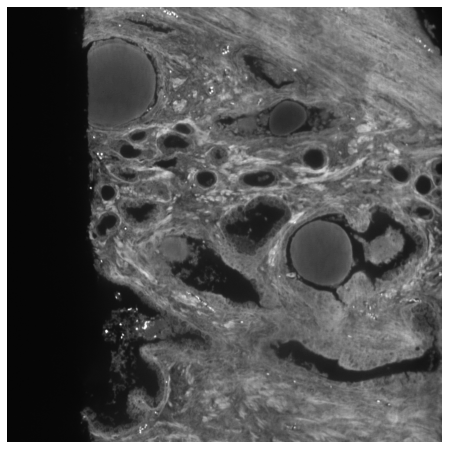

full_height 712


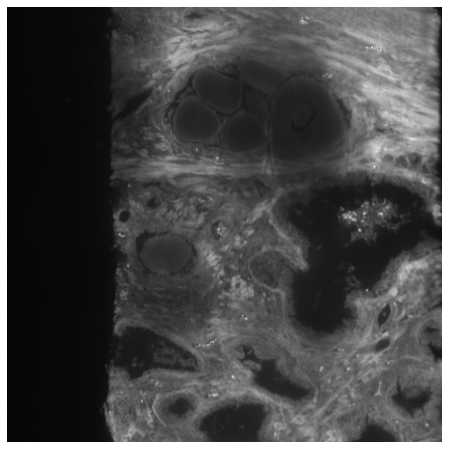

----------- dod_s198a_blk014
nf_top 375
reading top half...
len(top_half) 375


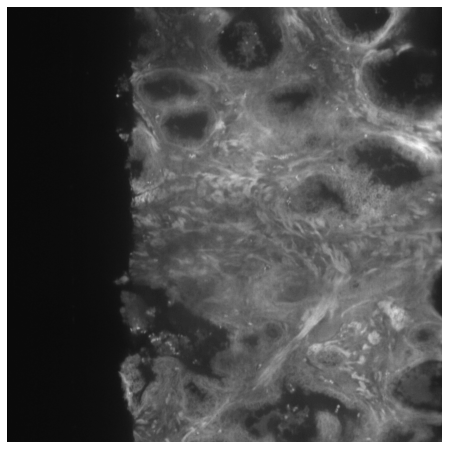

nf_bot 371
reading bottom half...
len(bot_half) 371


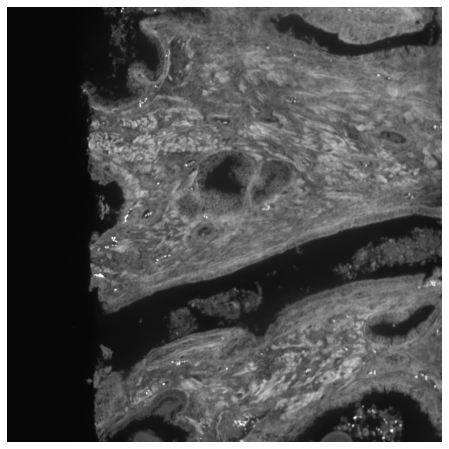

full_height 712


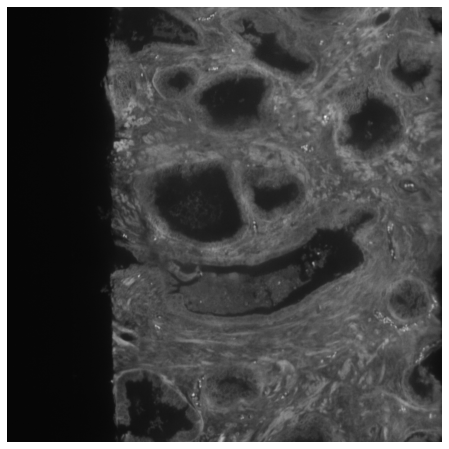

----------- dod_s198a_blk015
nf_top 375
reading top half...
len(top_half) 375


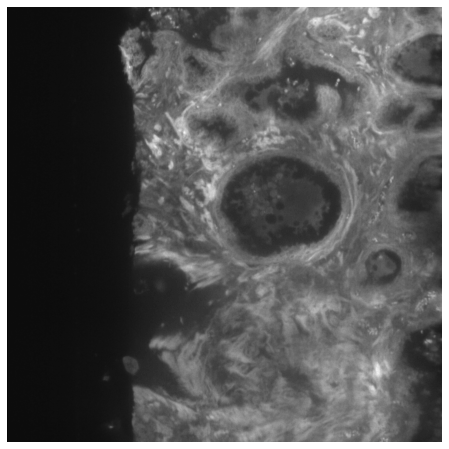

nf_bot 371
reading bottom half...
len(bot_half) 371


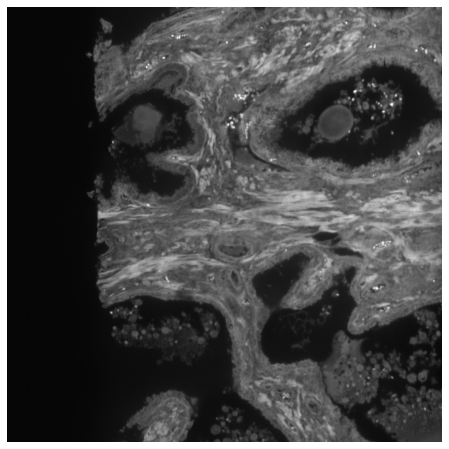

full_height 712


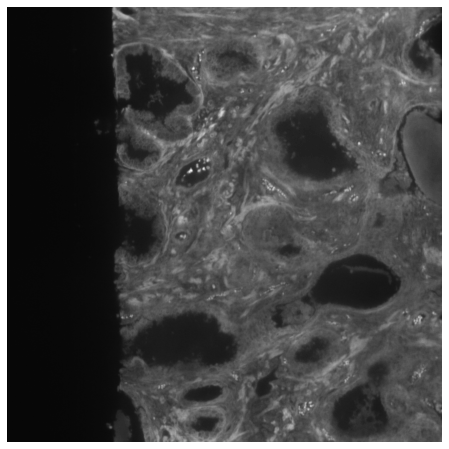

----------- dod_s198a_blk016
nf_top 375
reading top half...
len(top_half) 375


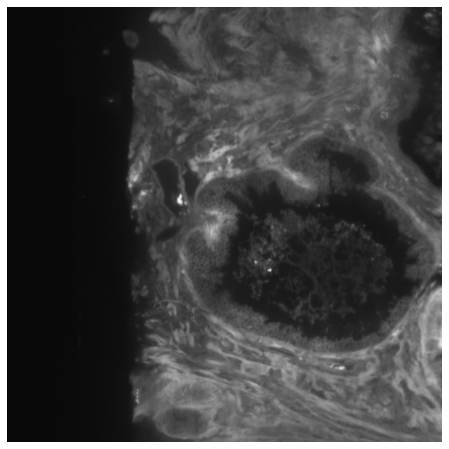

nf_bot 371
reading bottom half...
len(bot_half) 371


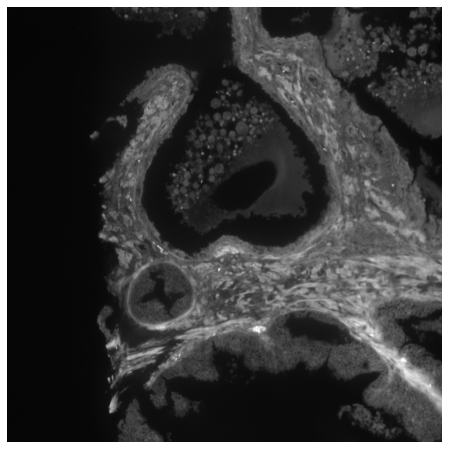

full_height 712


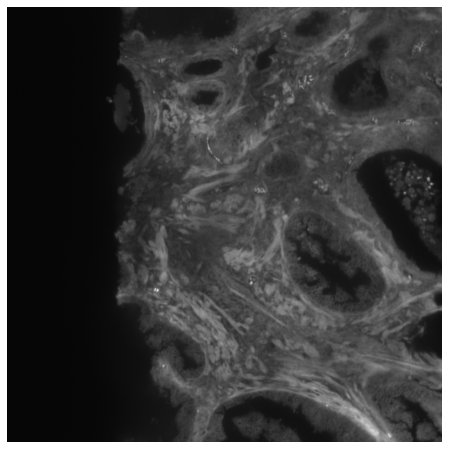

----------- dod_s198a_blk017
nf_top 375
reading top half...
len(top_half) 375


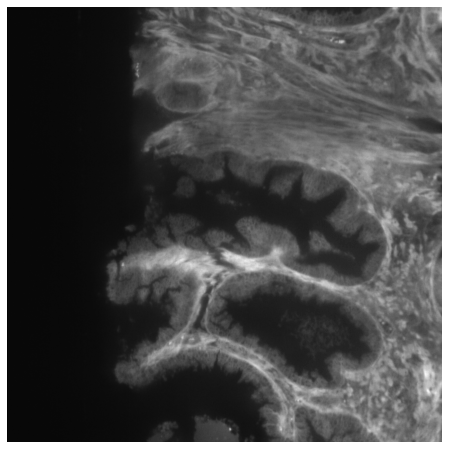

nf_bot 371
reading bottom half...
len(bot_half) 371


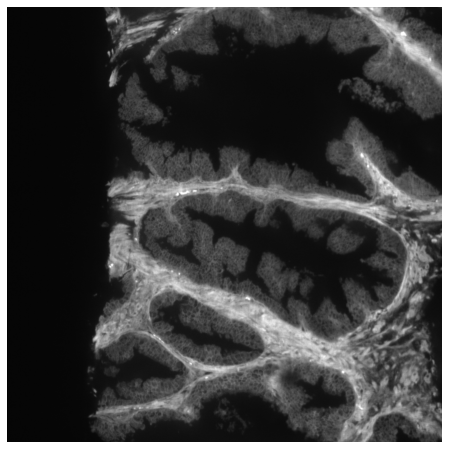

full_height 712


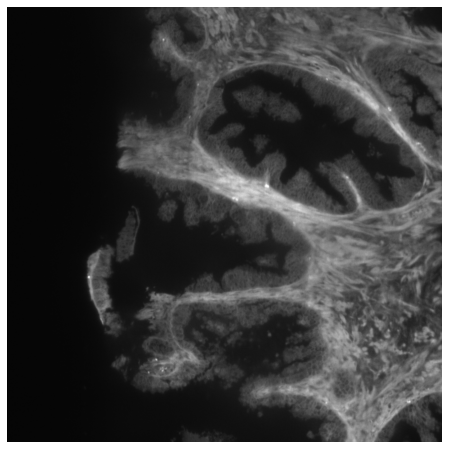

----------- dod_s198a_blk018
nf_top 375
reading top half...
len(top_half) 375


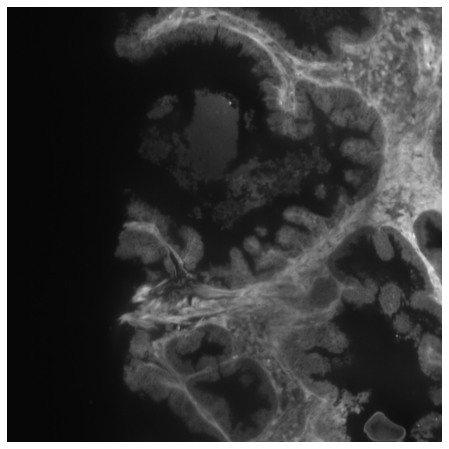

nf_bot 371
reading bottom half...
len(bot_half) 371


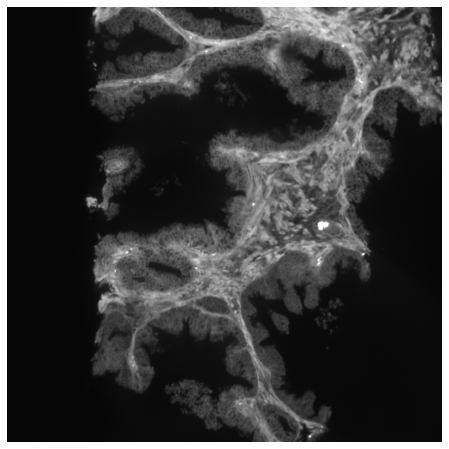

full_height 712


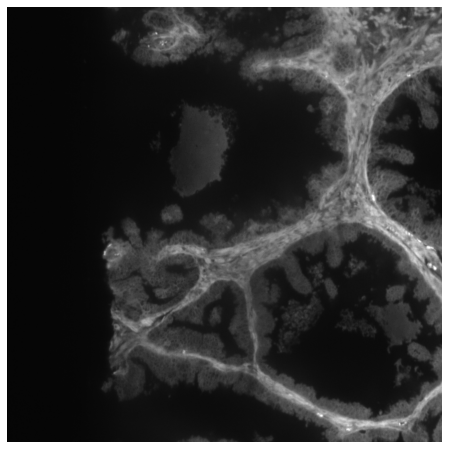

----------- dod_s198a_blk019
nf_top 375
reading top half...
len(top_half) 375


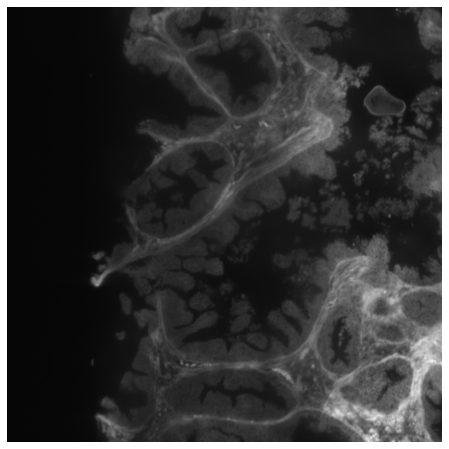

nf_bot 371
reading bottom half...
len(bot_half) 371


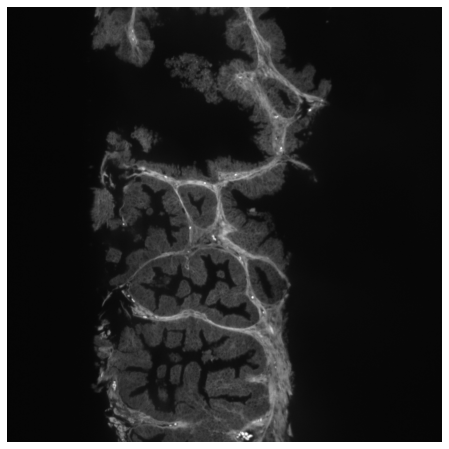

full_height 712


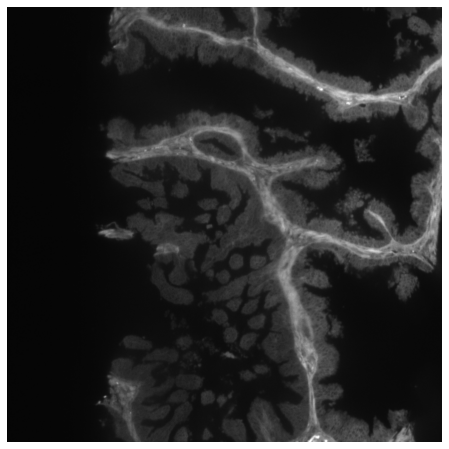

----------- dod_s198a_blk020
nf_top 375
reading top half...
len(top_half) 375


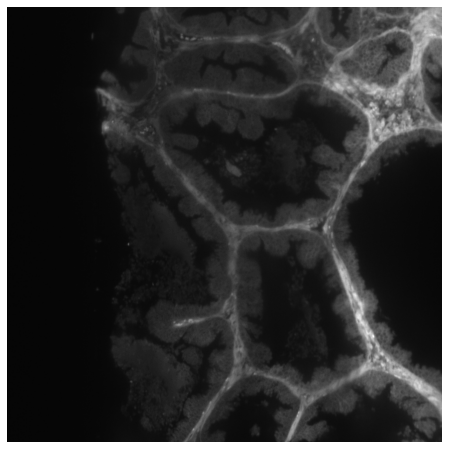

nf_bot 371
reading bottom half...
len(bot_half) 371


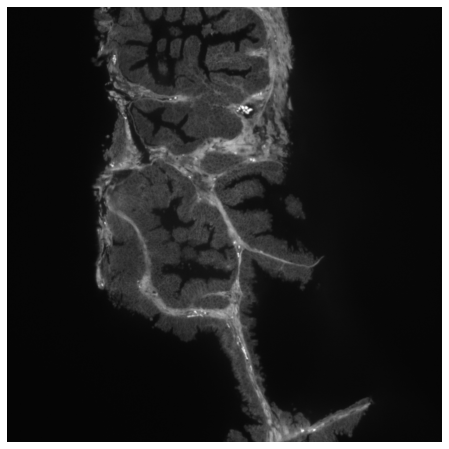

full_height 712


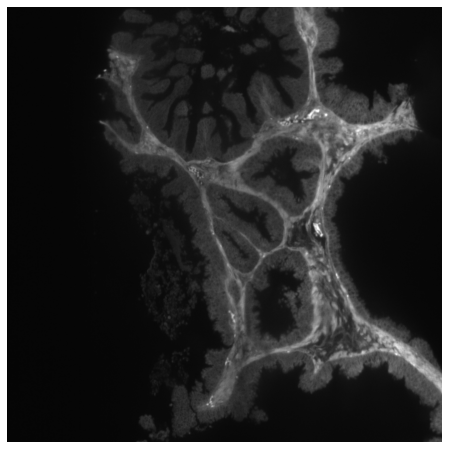

----------- dod_s198a_blk021
nf_top 375
reading top half...
len(top_half) 375


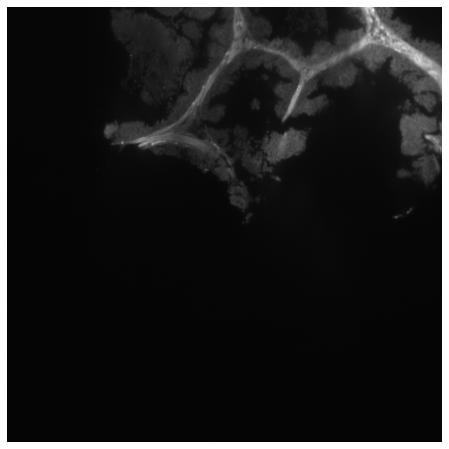

nf_bot 371
reading bottom half...
len(bot_half) 371


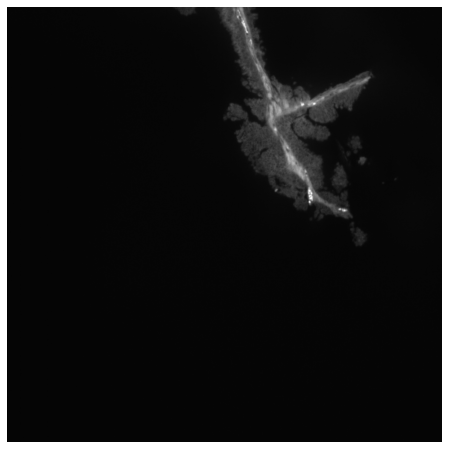

full_height 712


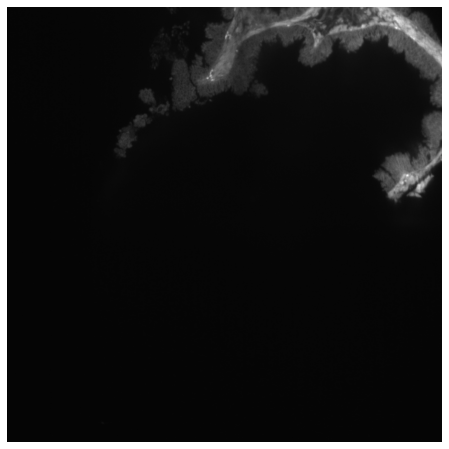

----------- dod_s198a_blk022
nf_top 375
reading top half...
len(top_half) 375


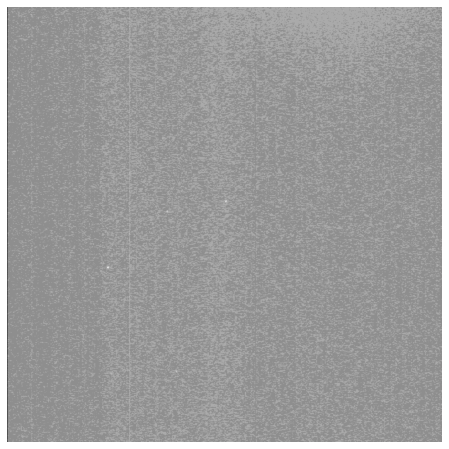

nf_bot 371
reading bottom half...
len(bot_half) 371


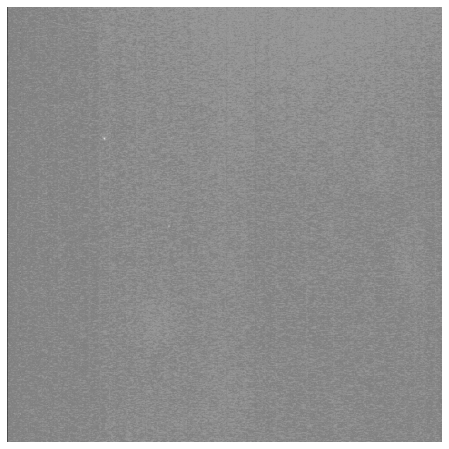

full_height 712


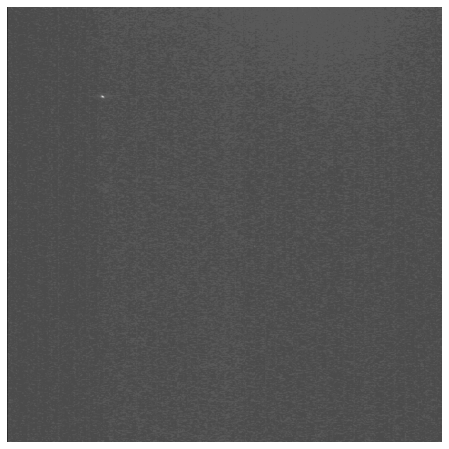

----------- dod_s198a_blk023
nf_top 375
reading top half...
len(top_half) 375


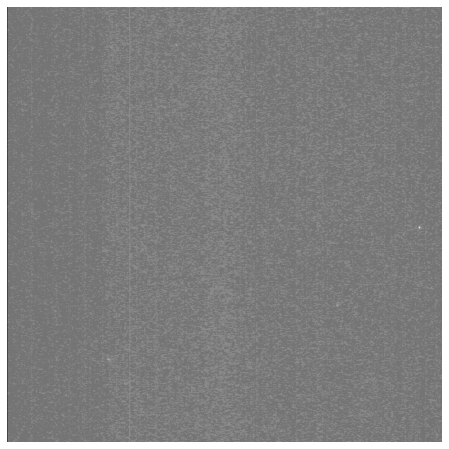

nf_bot 371
reading bottom half...
len(bot_half) 371


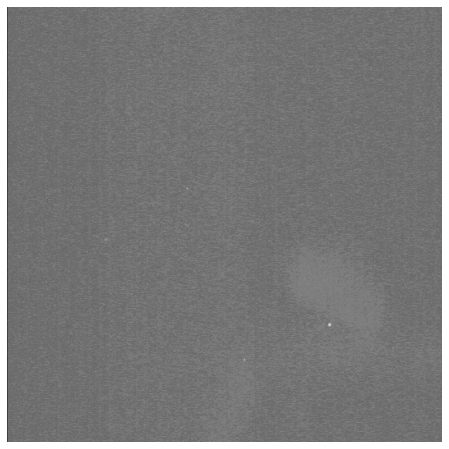

full_height 712


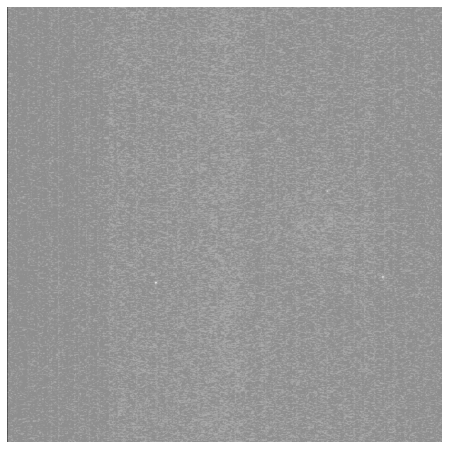

48
24
----------- dod_s198e_blk000
nf_top 375
reading top half...
len(top_half) 375


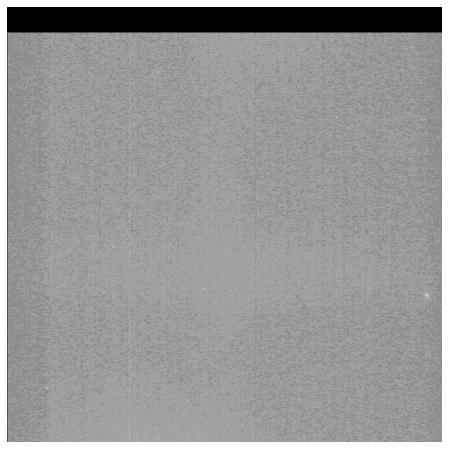

nf_bot 371
reading bottom half...
len(bot_half) 371


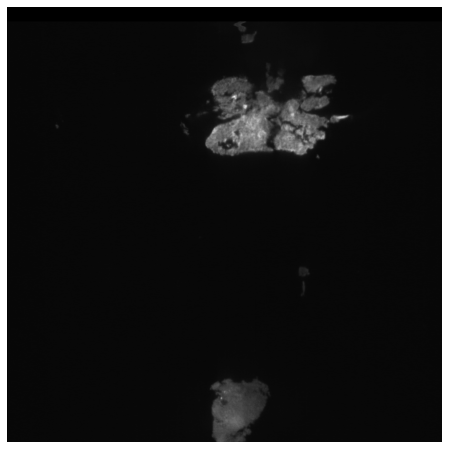

full_height 712


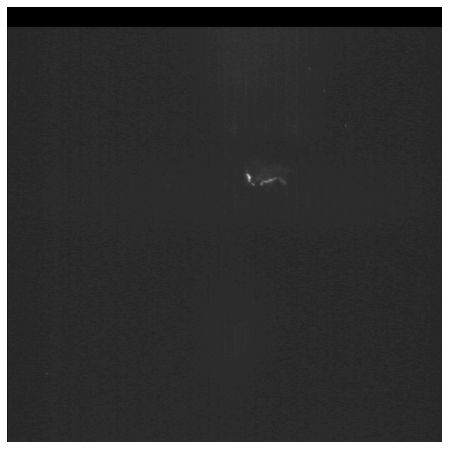

----------- dod_s198e_blk001
nf_top 375
reading top half...
len(top_half) 375


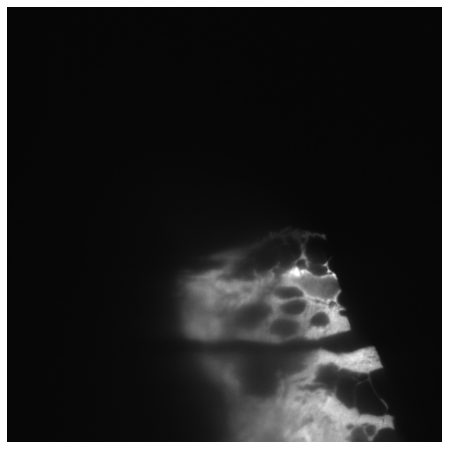

nf_bot 371
reading bottom half...
len(bot_half) 371


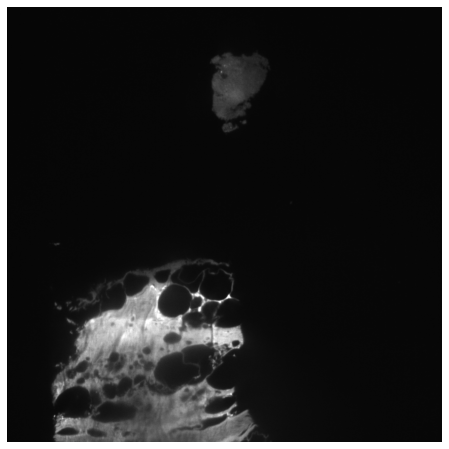

full_height 712


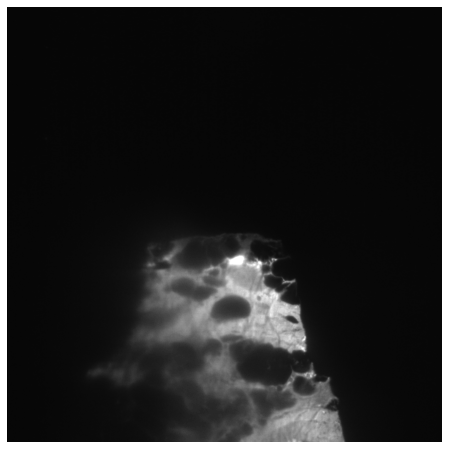

----------- dod_s198e_blk002
nf_top 375
reading top half...
len(top_half) 375


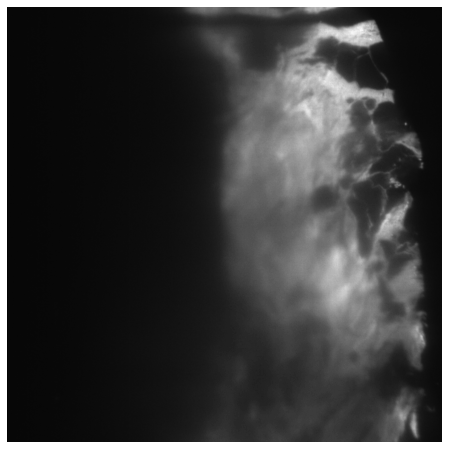

nf_bot 371
reading bottom half...
len(bot_half) 371


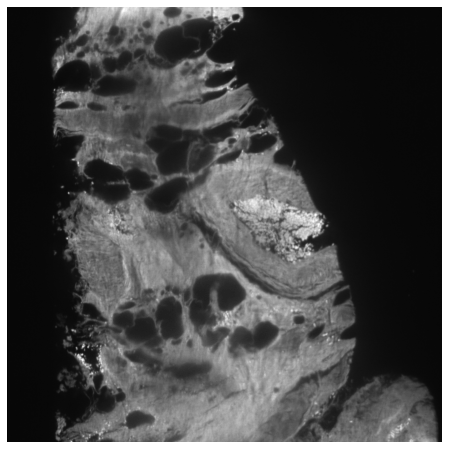

full_height 712


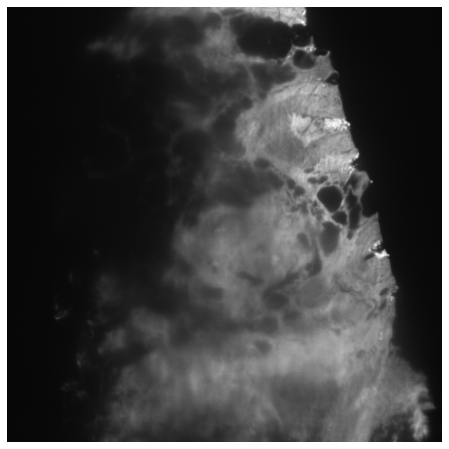

----------- dod_s198e_blk003
nf_top 375
reading top half...
len(top_half) 375


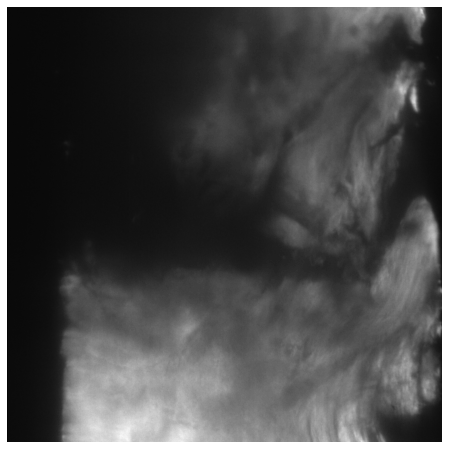

nf_bot 371
reading bottom half...
len(bot_half) 371


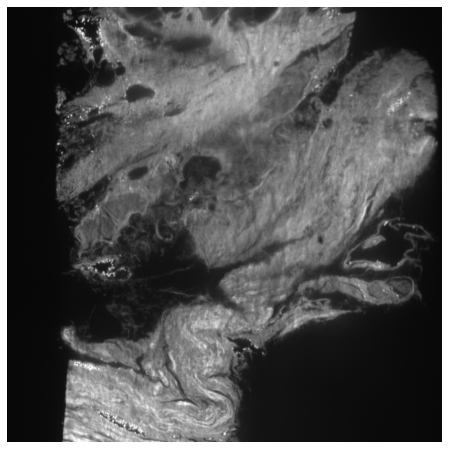

full_height 712


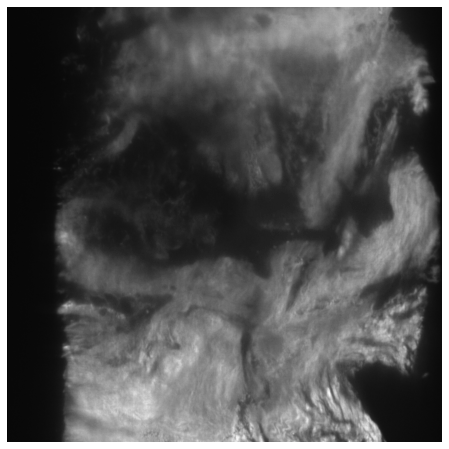

----------- dod_s198e_blk004
nf_top 375
reading top half...
len(top_half) 375


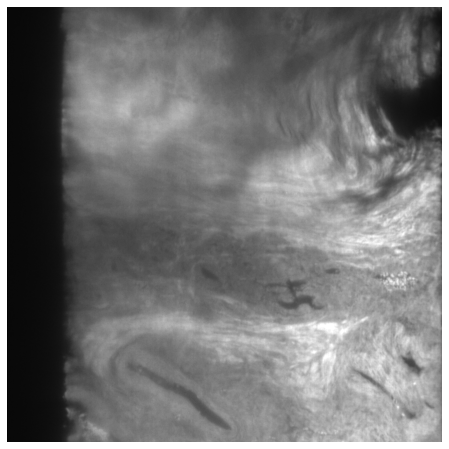

nf_bot 371
reading bottom half...
len(bot_half) 371


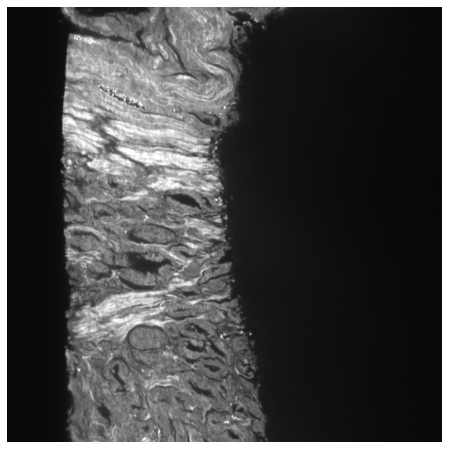

full_height 712


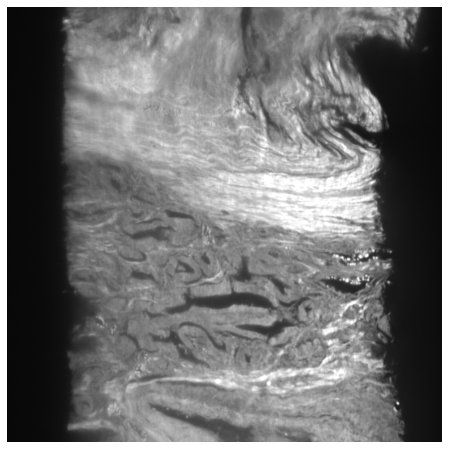

----------- dod_s198e_blk005
nf_top 375
reading top half...
len(top_half) 375


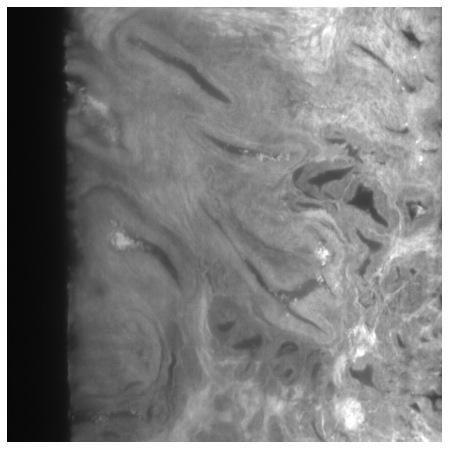

nf_bot 371
reading bottom half...
len(bot_half) 371


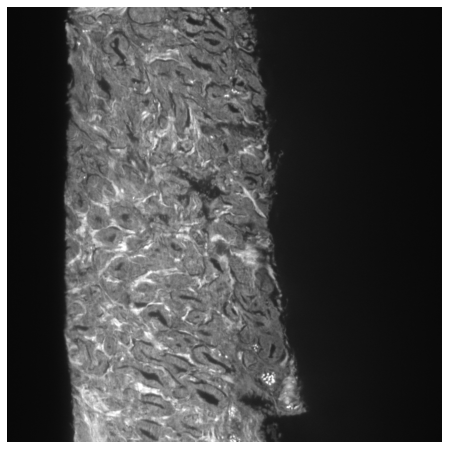

full_height 712


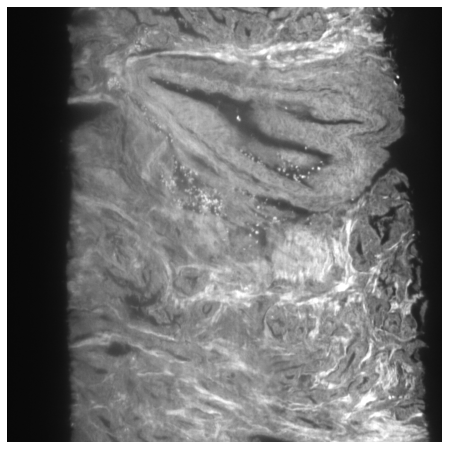

----------- dod_s198e_blk006
nf_top 375
reading top half...
len(top_half) 375


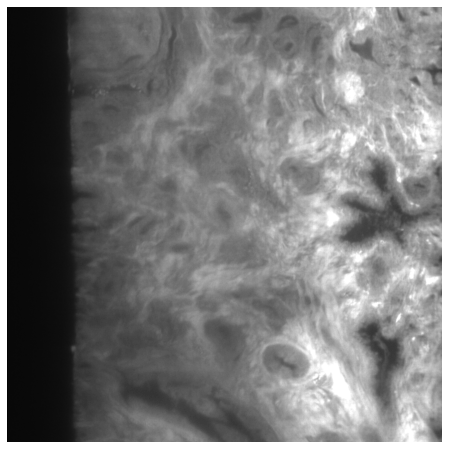

nf_bot 371
reading bottom half...
len(bot_half) 371


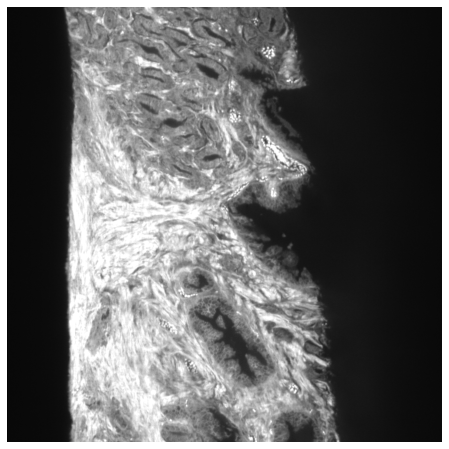

full_height 712


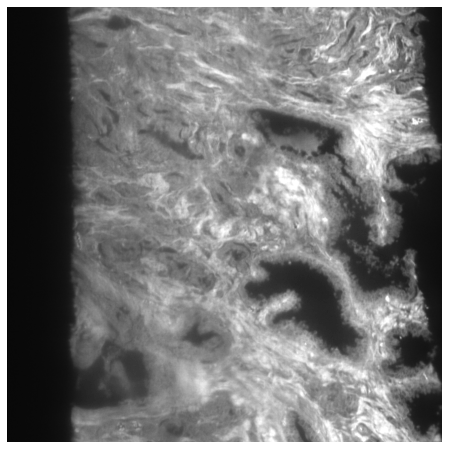

----------- dod_s198e_blk007
nf_top 375
reading top half...
len(top_half) 375


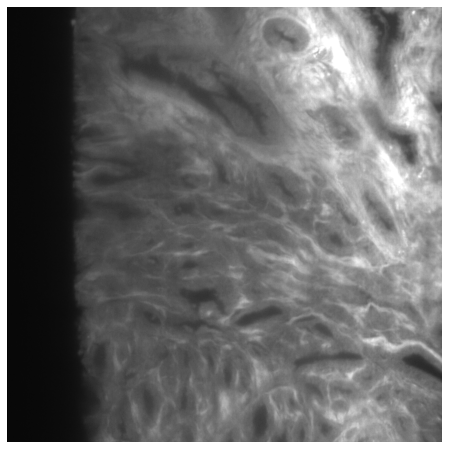

nf_bot 371
reading bottom half...
len(bot_half) 371


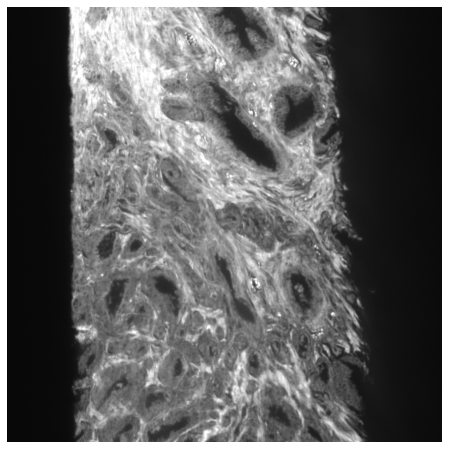

full_height 712


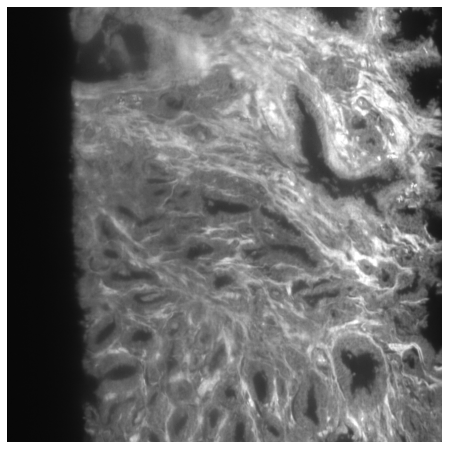

----------- dod_s198e_blk008
nf_top 375
reading top half...
len(top_half) 375


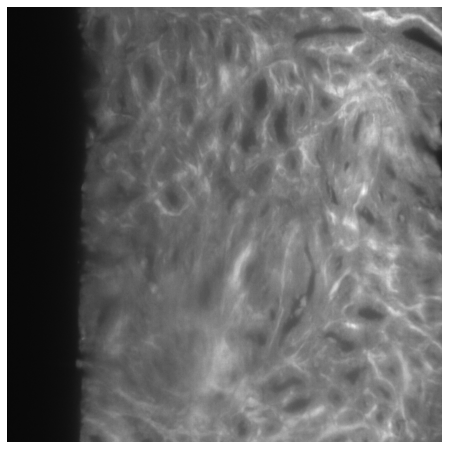

nf_bot 371
reading bottom half...
len(bot_half) 371


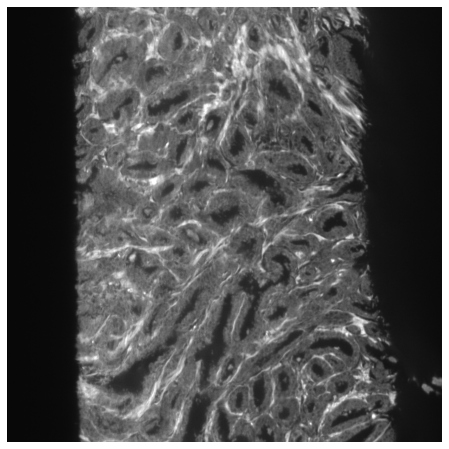

full_height 712


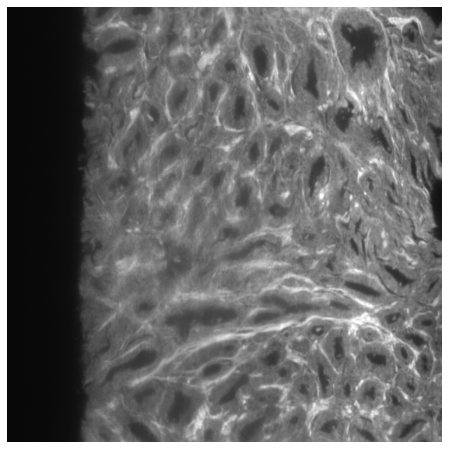

----------- dod_s198e_blk009
nf_top 375
reading top half...
len(top_half) 375


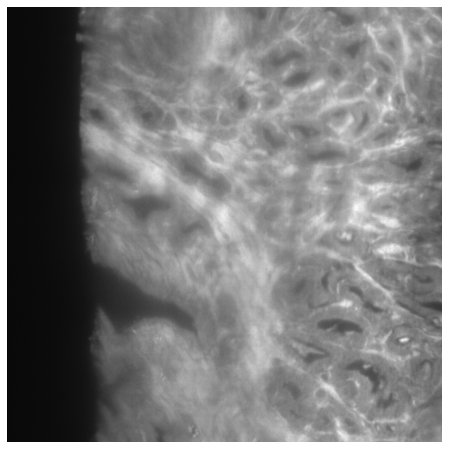

nf_bot 371
reading bottom half...
len(bot_half) 371


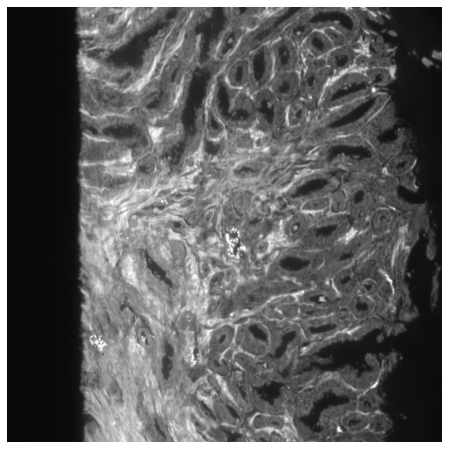

full_height 712


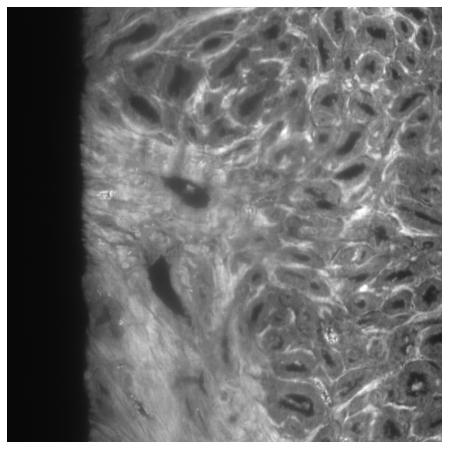

----------- dod_s198e_blk010
nf_top 375
reading top half...
len(top_half) 375


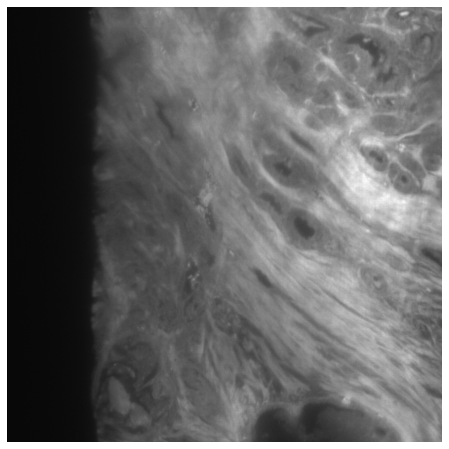

nf_bot 371
reading bottom half...
len(bot_half) 371


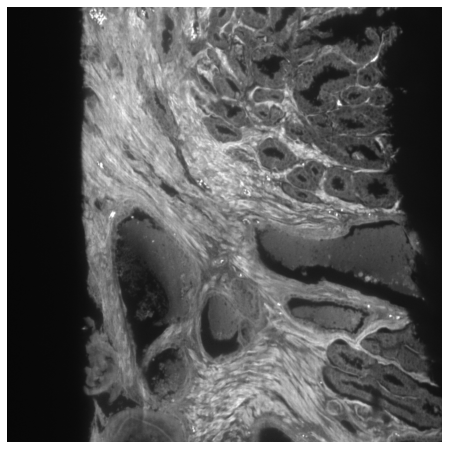

full_height 712


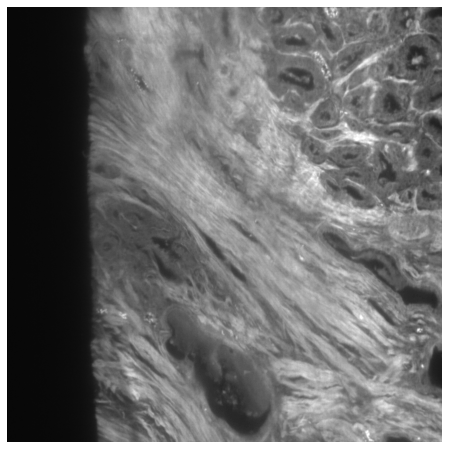

----------- dod_s198e_blk011
nf_top 375
reading top half...
len(top_half) 375


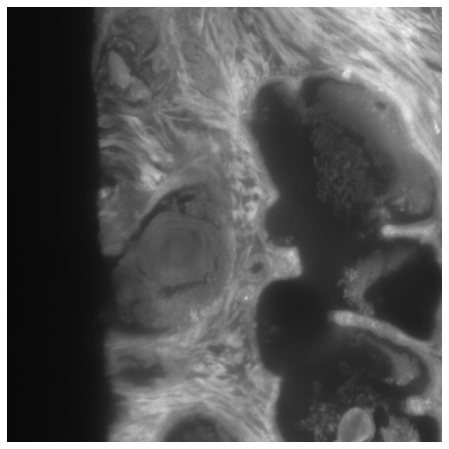

nf_bot 371
reading bottom half...
len(bot_half) 371


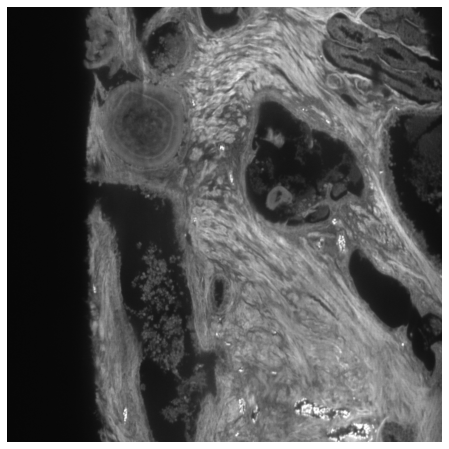

full_height 712


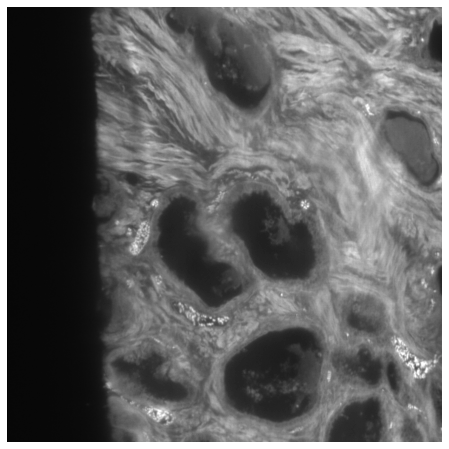

----------- dod_s198e_blk012
nf_top 375
reading top half...
len(top_half) 375


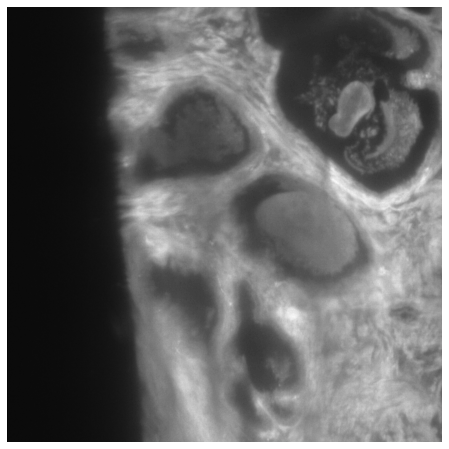

nf_bot 371
reading bottom half...
len(bot_half) 371


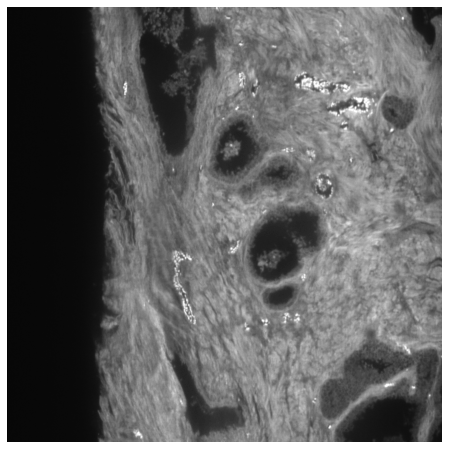

full_height 712


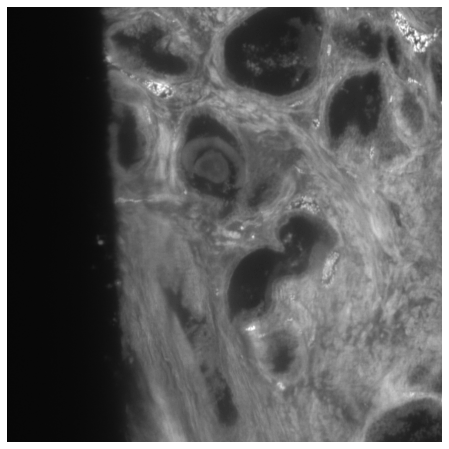

----------- dod_s198e_blk013
nf_top 375
reading top half...
len(top_half) 375


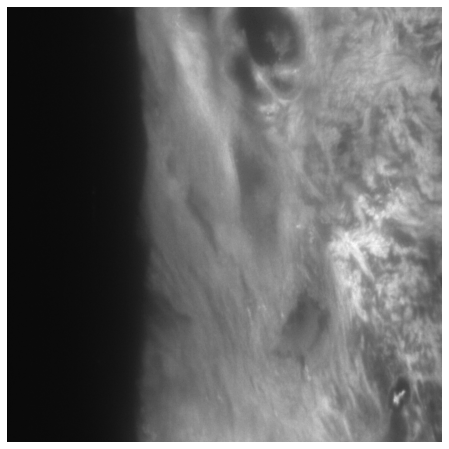

nf_bot 371
reading bottom half...
len(bot_half) 371


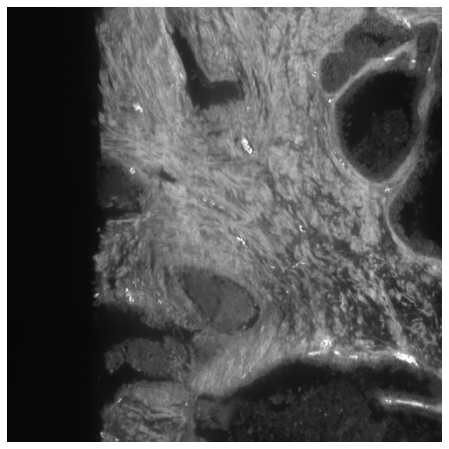

full_height 712


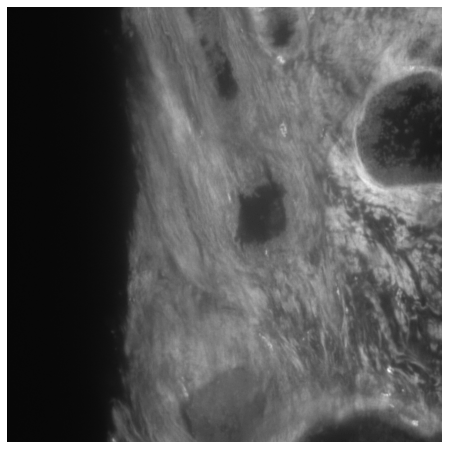

----------- dod_s198e_blk014
nf_top 375
reading top half...
len(top_half) 375


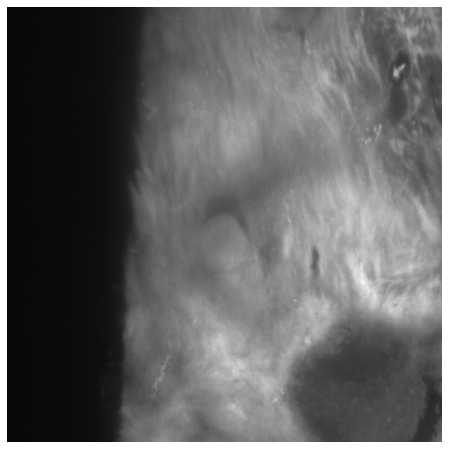

nf_bot 371
reading bottom half...
len(bot_half) 371


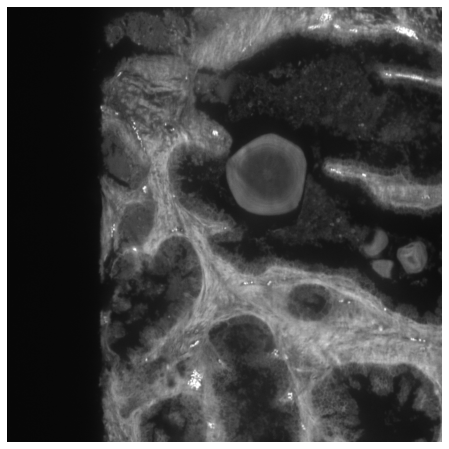

full_height 712


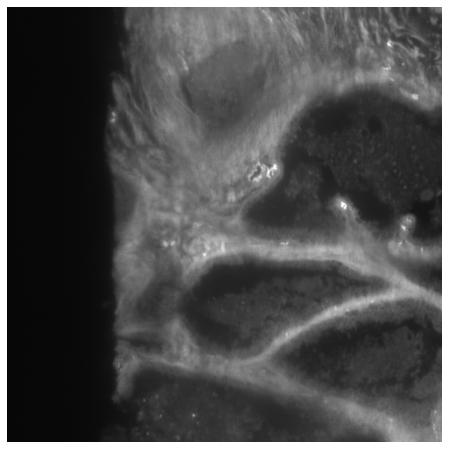

----------- dod_s198e_blk015
nf_top 375
reading top half...
len(top_half) 375


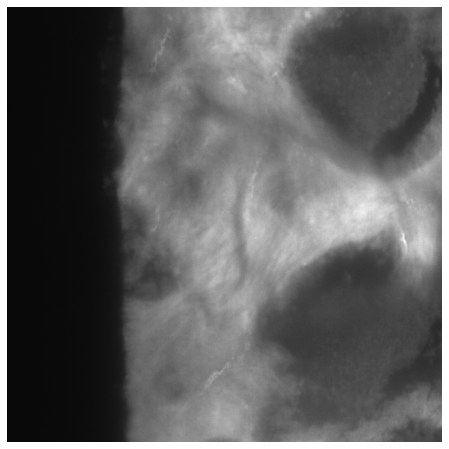

nf_bot 371
reading bottom half...
len(bot_half) 371


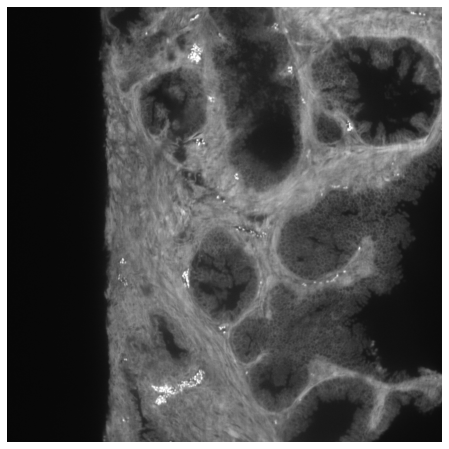

full_height 712


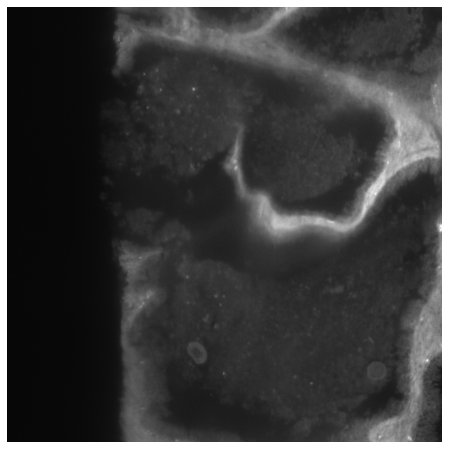

----------- dod_s198e_blk016
nf_top 375
reading top half...
len(top_half) 375


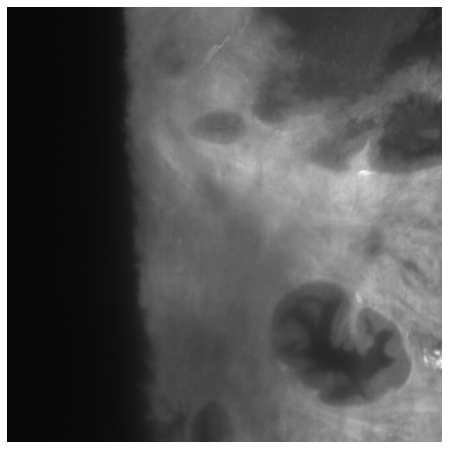

nf_bot 371
reading bottom half...
len(bot_half) 371


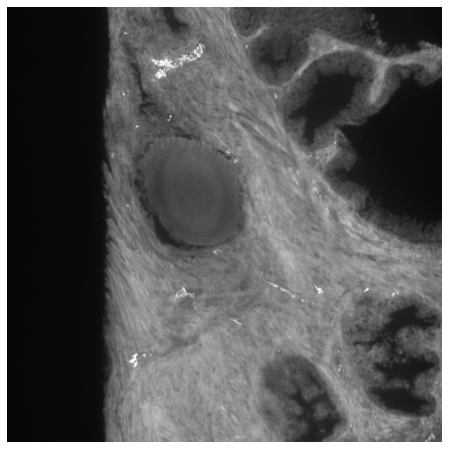

full_height 712


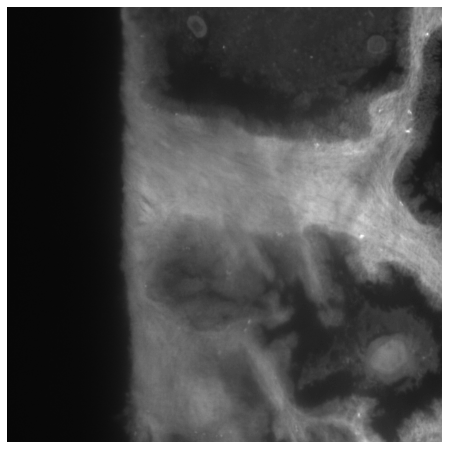

----------- dod_s198e_blk017
nf_top 375
reading top half...
len(top_half) 375


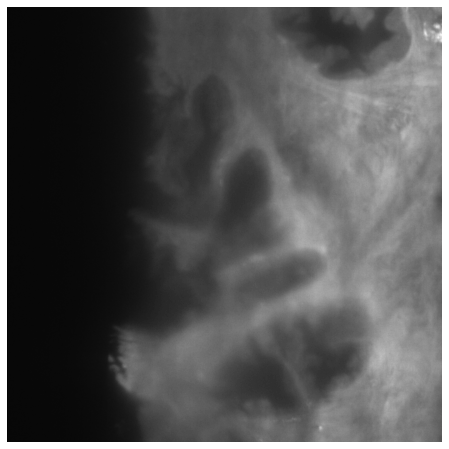

nf_bot 371
reading bottom half...
len(bot_half) 371


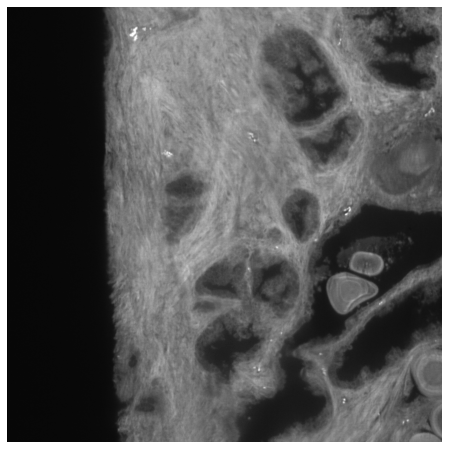

full_height 712


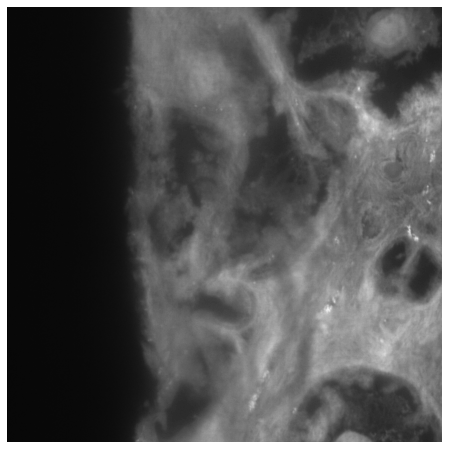

----------- dod_s198e_blk018
nf_top 375
reading top half...
len(top_half) 375


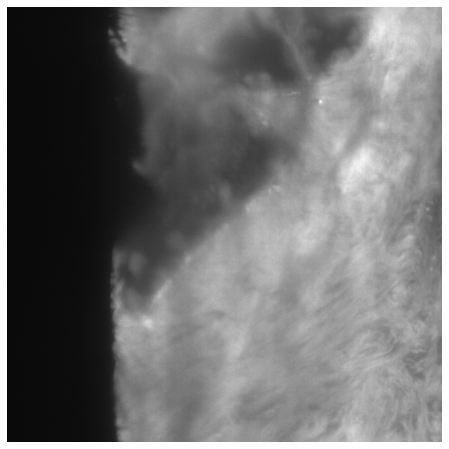

nf_bot 371
reading bottom half...
len(bot_half) 371


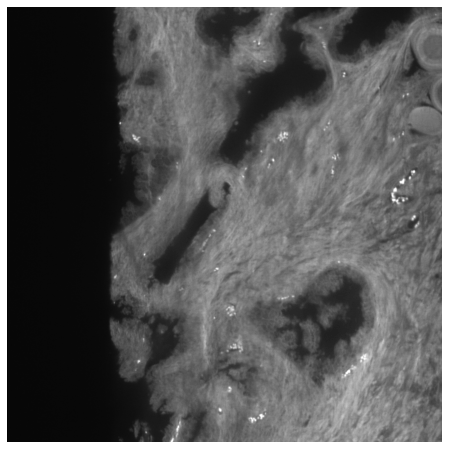

full_height 712


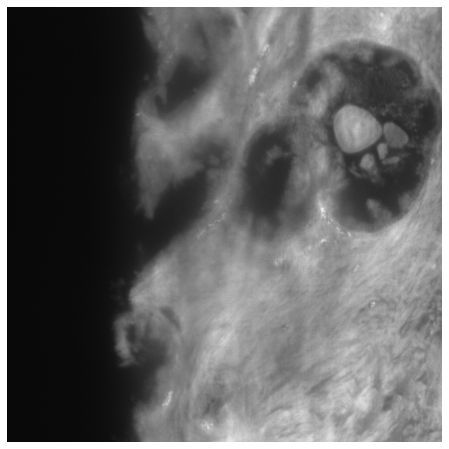

----------- dod_s198e_blk019
nf_top 375
reading top half...
len(top_half) 375


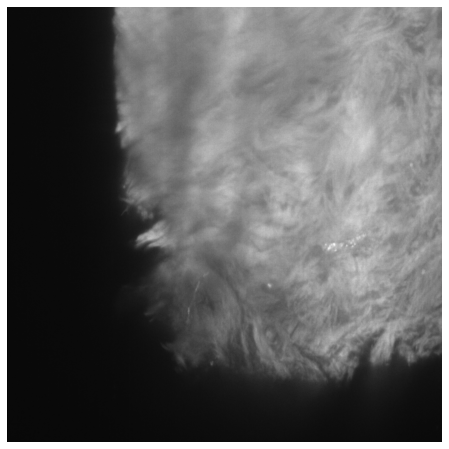

nf_bot 371
reading bottom half...
len(bot_half) 371


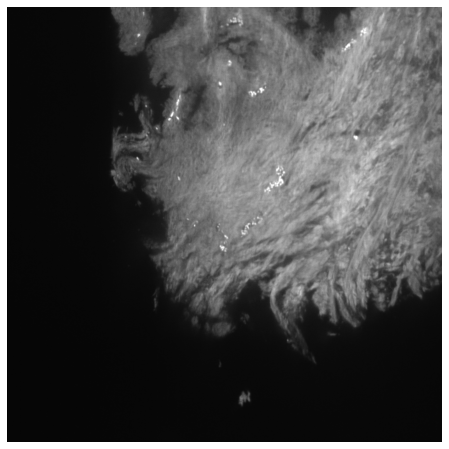

full_height 712


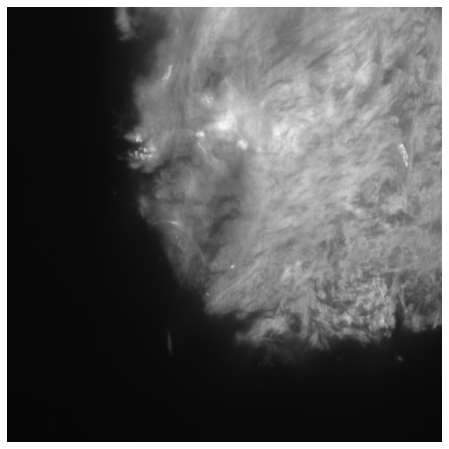

----------- dod_s198e_blk020
nf_top 375
reading top half...
len(top_half) 375


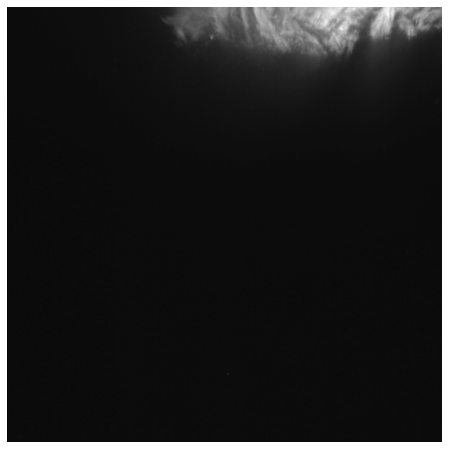

nf_bot 371
reading bottom half...
len(bot_half) 371


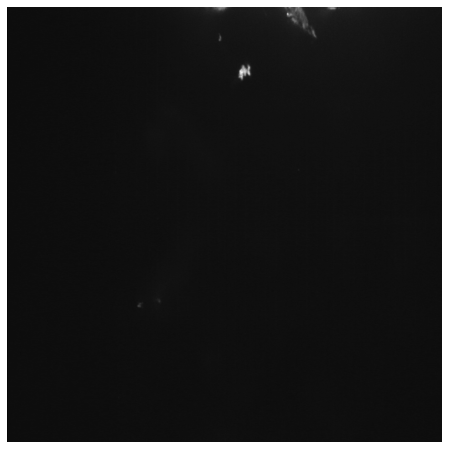

full_height 712


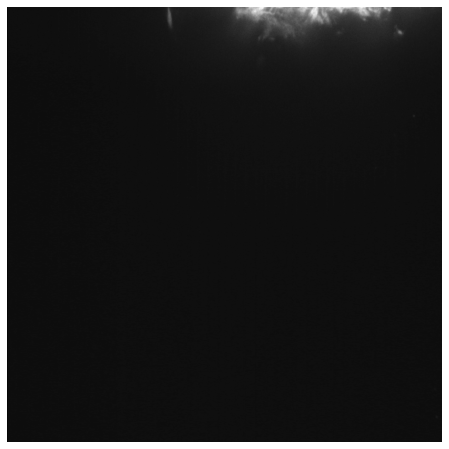

----------- dod_s198e_blk021
nf_top 375
reading top half...
len(top_half) 375


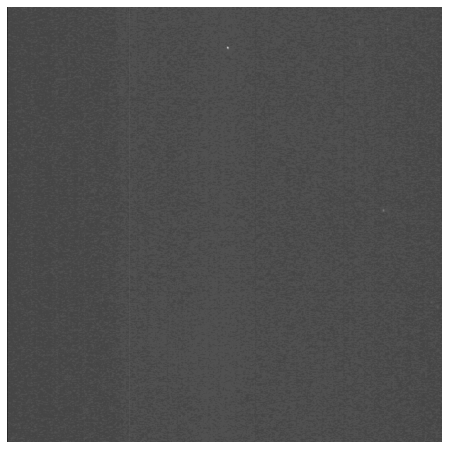

nf_bot 371
reading bottom half...
len(bot_half) 371


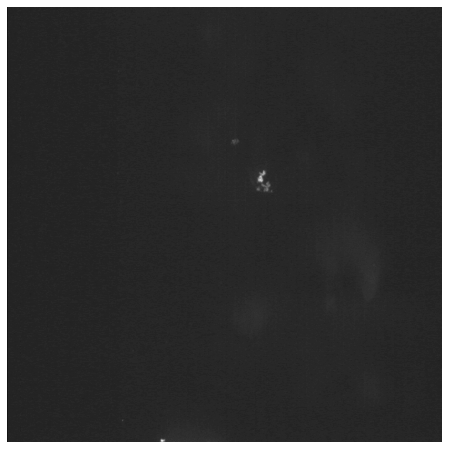

full_height 712


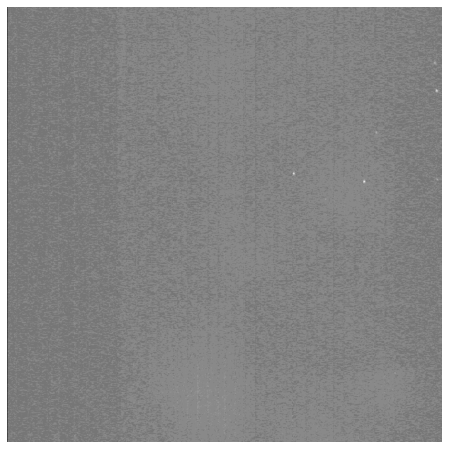

----------- dod_s198e_blk022
nf_top 375
reading top half...
len(top_half) 375


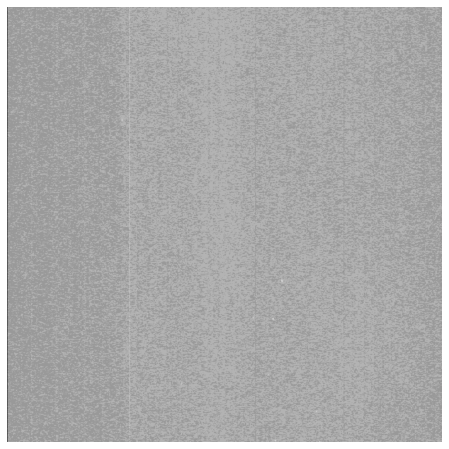

nf_bot 371
reading bottom half...
len(bot_half) 371


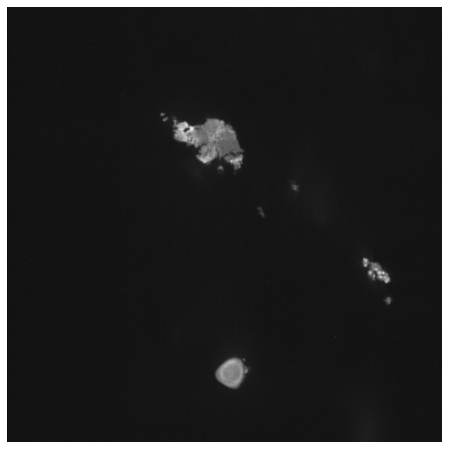

full_height 712


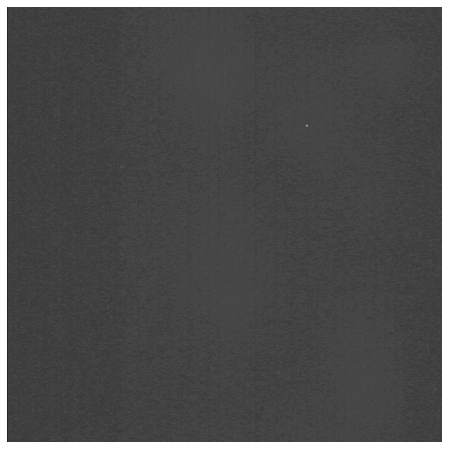

----------- dod_s198e_blk023
nf_top 375
reading top half...
len(top_half) 375


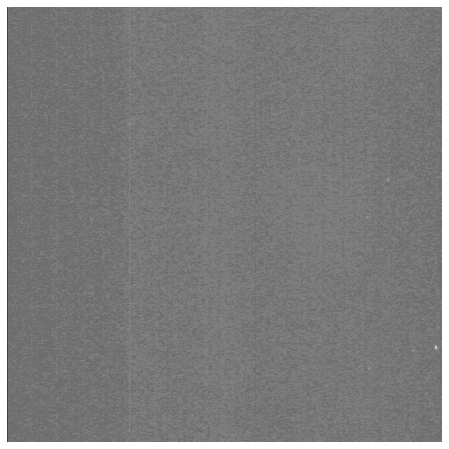

nf_bot 371
reading bottom half...
len(bot_half) 371


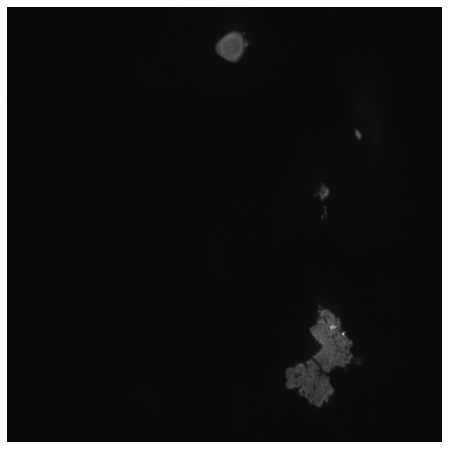

full_height 712


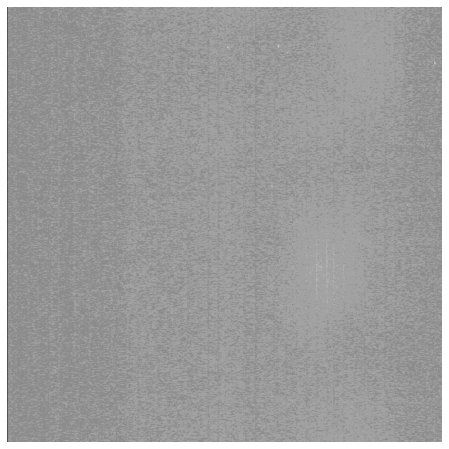

In [2]:
########batch process

biopsy_group = 's198_o' #change
biopsy_list = ['s198a', 's198e'] #change
ch_list = ['2'] #1 for nuc, 2 for cyto
ovlp = 0.25

for biopsy_name in biopsy_list:
    
    for ch in ch_list:
        
        ch_folder = 'Z:\\WX\\WX_test_dod\\whobio_sets\\'+biopsy_group+'\\test\\ch'+ch #c
        seq_list = glob.glob(os.path.join(ch_folder, 'dod_'+biopsy_name+'*'))
        print(len(seq_list))
        seq_name_list = []
        for seq in seq_list:
            seq_name = os.path.basename(seq)[:-1]
            if seq_name not in seq_name_list:
                seq_name_list.append(seq_name)
        print(len(seq_name_list))

        full_seq_folder = 'Z:\\WX\\WX_test_dod\\whobio_sets\\vid2vid_results\\'+biopsy_group+'\\full_seq' #c
        if not os.path.exists(full_seq_folder):
            os.makedirs(full_seq_folder)
        
        ch_save_folder = os.path.join(full_seq_folder, 'Fused_dod_'+biopsy_name+'\\ch'+ch)
        if not os.path.exists(ch_save_folder):
            os.makedirs(ch_save_folder)
            
            
        #----------start assembly
        for seq_idx, seq_name in enumerate(seq_name_list): #seq_name_list, (all the blocks in this biopsy)

            print('-----------', seq_name)

            #top part    
            top_seq_dir = os.path.join(ch_folder, seq_name+'t')
            top_seq_frame_list = glob.glob(os.path.join(top_seq_dir,'dod*.jpg')) #cyto or nuc
            nf_top = len(top_seq_frame_list)
            print('nf_top', nf_top)
            #read top
            top_half = np.zeros((nf_top,1024,1024),dtype = np.uint8)
            print('reading top half...')
            for idx in range(nf_top): #range(nf_top)
                frame_dir = top_seq_frame_list[idx]
                frame = io.imread(frame_dir, as_gray = True)
                if np.amax(frame)<2:
                    frame = frame*255
                top_half[nf_top-idx-1] = frame.astype(np.uint8) #go backwards!!!!!
            print('len(top_half)', len(top_half))
            image_show(top_half[len(top_half)//2])

            #bottom part
            bot_seq_dir = os.path.join(ch_folder, seq_name+'b')
            bot_seq_frame_list = glob.glob(os.path.join(bot_seq_dir,'dod*.jpg'))
            nf_bot = len(bot_seq_frame_list)
            print('nf_bot', nf_bot)
            #read bottom
            bot_half = np.zeros((nf_bot,1024,1024),dtype = np.uint8)
            print('reading bottom half...')
            for idx in range(nf_bot):
                frame_dir = bot_seq_frame_list[idx]
                frame = io.imread(frame_dir, as_gray = True)
                if np.amax(frame)<2:
                    frame = frame*255
                bot_half[idx] = frame.astype(np.uint8)
            print('len(bot_half)', len(bot_half))
            image_show(bot_half[len(bot_half)//2])

            #assemble whole seq (top and bottom)
            full_height = nf_top+nf_bot-34 #34 frames overlapping
            print('full_height', full_height)
            full_seq = np.zeros((full_height,1024,1024), dtype = np.uint8)
            full_seq[:nf_top] = top_half
            full_seq[nf_top:] = bot_half[34:]
            image_show(full_seq[len(full_seq)//2])

            #put this block into correct position in the whole biopsy
            if seq_idx==0:
                biopsy_length = int(1024*(len(seq_name_list)-1)*(1-ovlp)+1024)
                whobio = np.zeros((full_height, biopsy_length, 1024), dtype = np.uint8)

            l_strt = int(1024*seq_idx*(1-ovlp))
            l_end = int(1024*seq_idx*(1-ovlp)+1024)

            whobio[:,l_strt:l_end,:] = full_seq

        #save whole biopsy
        whobio_dir = os.path.join(ch_save_folder, biopsy_name+'_ch'+ch+'.tif')
        imsave(whobio_dir, whobio)        